In [1]:
import warnings
warnings.filterwarnings('ignore')

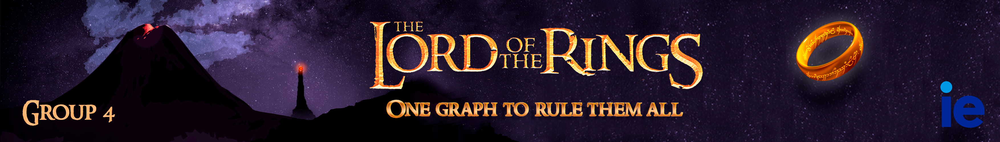

In [2]:
#Adding the header image
from IPython.display import Image
Image(filename='Images/header-image.png')

### Fellowship Members

- Alfonso Ferrándiz Hervella
- Dareen Shaheen Hamdy
- Diana Fernández
- Heba Aahed Mushtaha
- Maximilian Becker
- Salma Elguendy

Frodo and Sam walking to Mount Doom, Aragorn, Legolas and Gimli fighting in the Battle of Helm's Deep, Saruman's betrayal of Gandalf... It is very likely that all these stories sound familiar to you. And it is not strange, since we are talking about one of the most famous Sagas of all time: **The Lord of the Rings**

The Lord of the Rings was conceived by J.R.R. Tolkien in the 1930s as a sequel to his earlier work, The Hobbit. Originally, it was intended to be a single volume, but grew in scope and became a trilogy, formed by the books "The Fellowship of the Ring," "The Two Towers," and "The Return of the King." The story is set in Middle-earth, a fictional world created by Tolkien, and follows the journey of Frodo Baggins and his companions to destroy the One Ring and defeat the evil Sauron. The trilogy was translated into films which were released between 2001 and 2003. directed by Peter Jackson, and they have been crtically aclaimed and comercially successful, cementing the story's place in popular culture.

When we started brainstorming ideas for our Social Network Analysis final project, we discovered that The Lord of the Rings was not only hugely successful, but also **had many characters and a complex web of interactions between them.** This reason, together with the fact that many of the group members have grown up reading the books and watching the movies, have pushed us, like Frodo, to embark on a journey to **try to discover how the social world created by Tolkien really looks like.**

**Let's start the adventure!**

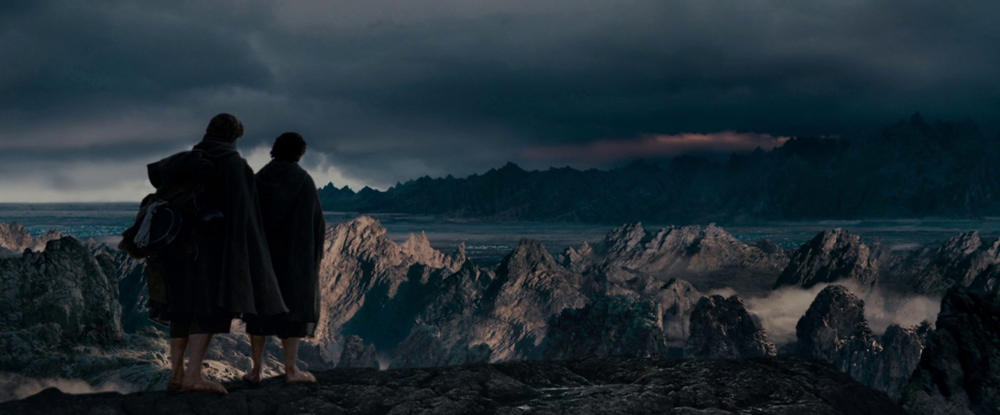

In [3]:
Image(filename='Images/the_journey_to_mordor.jpg')

# **0. Introduction and preparation of the environment**

## 0.1. Scope

The present project will focus on the analysis of the relationships between the characters of the Lord of the Rings trilogy, including the books and movies. Therefore, **the relationships of other Tolkien books or the new cinematographic products related to Middle-earth are outside the scope.**

Regarding the activities, we will perform an Exploratory Data Analysis (EDA), Graph Creation and metric analysis, Community Detection, Sentiment Analysis and Information Diffusion

## 0.2. Datasets used

Regarding the original datasets, we will use:

- Complete text of each of the 3 books written by Tolkien (LOTR1_book_CLEAN.txt, LOTR2_book_CLEAN.txt, LOTR3_book_CLEAN.txt)
- The complete scripts of each of the 3 movies directed by Peter Jackson (lotr_scripts.csv)
- Using SentiWordNet dataset which contains over 155,000 words with corresponding sentiment score.

CSV file used in this notebook:
- cleaned_name.csv
- edges.csv
- nodes.csv
- weightededges.csv
- nodes_chapter_sent.csv
- edges_chapters.csv
- nodes_with_sentiment.csv
- sentiment_per_character.csv

## 0.3. References

We cannot continue our project without mentioning some projects that we have used as inspiration and that has provided us with some of the techniques specially for treating the data at a first point:
- Specially, the work  "Analysing Lord of the Rings Trilogy with Data Science". A project by Nab-88 available on Github (https://github.com/Nab-88/social-graphs-and-interactions)
- "The complex social network from The Lord of The Rings" by Mauricio Aparecido Ribeiro, Roberto Antonio Vosgerau, Maria Larissa Pereira Andruchiw, Sandro Ely de Souza Pinto
- "Analyzing the Lord of the Rings data" a Kaggle project by xvivancos.


## 0.3. Importing the Libraries

In [4]:
# Installing what is needed (uncomment if you don't have these packages installed)

# %pip install nltk
# %pip install numpy
# %pip install community
# %pip install matplotlib
# %pip install pyvis
# %pip install pyvis.network

In [5]:
# Importing what is needed
# -*- coding: utf-8 -*-
#% matplotlib inline
import re, math, string, nltk, random, io, xml, os, urllib, json, warnings, collections
import numpy as np
import nltk
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
import pandas as pd
from scipy import sparse
import matplotlib.pyplot as plt
#from scipy.misc import imread
#from wordcloud import WordCloud, ImageColorGenerator
from collections import defaultdict, Counter
import networkx as nx
import community as community
from PIL import Image
import seaborn as sns
import matplotlib.ticker as ticker
import pyvis.network as net


# **1. Preparing the data**

Some previous steps have to be performed in order to get a proper data to work with. We will start by extracting a dataframe with the network from the 3 books

In [6]:
#Importing nodes and edges of initial data (csv files)
nodes = pd.read_csv('dataset/nodes.csv')
edges = pd.read_csv('dataset/edges.csv')

In [7]:
#Read in all the volumes. Remove all occurencese of \n (newline).
with open('./dataset/LOTR1_book_CLEAN.txt', 'r',encoding='utf-8') as myfile:
    LOTR1_book=myfile.read()
with open('./dataset/LOTR2_book_CLEAN.txt', 'r',encoding='utf-8') as myfile:
    LOTR2_book=myfile.read()
with open('./dataset/LOTR3_book_CLEAN.txt', 'r',encoding='utf-8') as myfile:
    LOTR3_book=myfile.read()

In [8]:
#The three volume's each consist of two Books, which we need to split by to be able to split by chapter.
#Moreover, volumes two and three include some junk at the front which we throw out.
LOTR1_book = LOTR1_book.split('BOOK')
LOTR2_book = LOTR2_book.split('BOOK')
LOTR2_book.pop(0)
LOTR3_book = LOTR3_book.split('BOOK')
LOTR3_book.pop(0)

#Now we can split each book by chapters.
LOTR1_prologue_chapters = LOTR1_book[0].split('Chapter')
LOTR1_book1_chapters = LOTR1_book[1].split('Chapter')
LOTR1_book2_chapters = LOTR1_book[2].split('Chapter')
LOTR2_book1_chapters = LOTR2_book[0].split('Chapter') #Rétt
LOTR2_book2_chapters = LOTR2_book[1].split('Chapter') #Rétt
LOTR3_book1_chapters = LOTR3_book[0].split('Chapter')
LOTR3_book2_chapters = LOTR3_book[1].split('Chapter')

#Again we need to pop out some junk at the beginning.
LOTR1_book1_chapters.pop(0)
LOTR1_book2_chapters.pop(0)
LOTR2_book1_chapters.pop(0)
LOTR2_book2_chapters.pop(0)
LOTR3_book1_chapters.pop(0)
LOTR3_book2_chapters.pop(0)
print('Data cleaning complete.')

Data cleaning complete.


In [9]:
#Then we add up everything to have the three volumes on a nice format.
LOTR_volume1 = LOTR1_book1_chapters+LOTR1_book2_chapters
LOTR_volume2 = LOTR2_book1_chapters+LOTR2_book2_chapters
LOTR_volume3 = LOTR3_book1_chapters+LOTR3_book2_chapters

#Now we have all the chapters of the three books 
All_chapter = LOTR1_prologue_chapters + LOTR_volume1 + LOTR_volume2 + LOTR_volume3
#These chapters shall be used later in sentiment analysis per chapter and plotting the corresponding graph

In [10]:
#We define a function to create a list of all the characters in the book and store it in a csv file
def create_list_of_character():
    df_perso = pd.read_csv("./dataset/cleaned_name.csv")
    liste_of_names = []
    for row in df_perso.iterrows():
        name = row[1].Names
        liste_of_names.append(name)
    return liste_of_names

liste_of_names2 = create_list_of_character()

In [11]:
#We define a function to look for the connection between characters in the book based on their appearance in the same chapter
def look_for_connection_in_book(list_of_characters, book):
    connection_chapter = []
    for chapter in book:
        people_in_chapter = []
        for character in list_of_characters:
            if character in chapter:
                people_in_chapter.append(character)
                continue
        connection_chapter.append(people_in_chapter)
    return connection_chapter

In [12]:
#We apply the look_for_connection_in_book function to the three volumes and all the chapters
new_network1 = look_for_connection_in_book(liste_of_names2,LOTR_volume1)
new_network2 = look_for_connection_in_book(liste_of_names2,LOTR_volume2)
new_network3 = look_for_connection_in_book(liste_of_names2,LOTR_volume3)
new_network4 = look_for_connection_in_book(liste_of_names2,All_chapter)

In [13]:
len(new_network4)


67

In [14]:
#We define a function to create the edges of the network
def create_edges_book(list_of_names_per_chapter):
    list_of_edges = []
    for chapter in list_of_names_per_chapter:
        sub_list = []
        n = len(chapter)
        i = 0
        if n == 1:
            sub_list.append((chapter[i],chapter[i]))
        else:
            while i < n:
                j = i + 1
                while j < n:
                    sub_list.append((chapter[i],chapter[j]))
                    j += 1
                i += 1
        list_of_edges.append(sub_list)
    return list_of_edges

#We define a function to clean the edges of the network, returning a dictionary with the edges as keys and the weight of the edge as values
def cleaning_edges(list_of_edges):
    cleaned_edges = []
    dict_edges = {}
    for chapter in list_of_edges:
        for edge in chapter:
            if len(cleaned_edges) == 0:
                cleaned_edges.append(edge)
                dict_edges[edge] = 1
            elif edge in cleaned_edges:

                dict_edges[edge] += 1
            else:
                count = 0
                for element in cleaned_edges:
                    if edge[1] in element[0]:
                        if edge[0] in element[1]:
                            dict_edges[element] += 1
                            break
                        else:
                            continue
                    count += 1
                if (count == len(cleaned_edges)):
                    cleaned_edges.append(edge)
                    dict_edges[edge] = 1    
    return dict_edges
            
            
#We define a function to create the network, using networkx
def build_network(dict_of_edges_weighted):
    G = nx.Graph()
    for edge, weight in dict_of_edges_weighted.items():
        node1 = edge[0]
        node2 = edge[1]
        G.add_edge(node1,node2, weight = weight)
    return G


def create_taille(graph):
    l = []
    for element in graph.nodes():
        l.append(graph.degree(element, weight='weight')*100)
    return l

In [15]:
#We apply the function create_edges_book to the previously obtained connections between characters
edges1 = create_edges_book(new_network1)
edges2 = create_edges_book(new_network2)
edges3 = create_edges_book(new_network3)
edges_all  = create_edges_book(new_network4)

In [16]:
#We apply the cleaning_edges function to the edges of the network, obtaining weighted edges
weighted_edges1 = cleaning_edges(edges1)
weighted_edges2 = cleaning_edges(edges2)
weighted_edges3 = cleaning_edges(edges3)
weighted_edges_all = cleaning_edges(edges_all)

In [17]:
#Finally, we are able to create a dataframe containing all the weighted edges and store it in a csv file
df_edges = pd.DataFrame.from_dict(weighted_edges_all, orient='index', columns=['weight'])
#df_edges.to_csv("./dataset/weightededges.csv")

# **2. Exploratory Data Analysis (EDA)**

 Through the lens of data analysis, we can uncover hidden patterns and insights, revealing new perspectives on this timeless story. So let us journey forth, and delve into the data of the Lord of the Rings, to uncover the secrets that lie within.

In [18]:
#Print the main info of nodes
nodes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 125 entries, 0 to 124
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Index      125 non-null    object
 1   Character  125 non-null    object
 2   Race       125 non-null    object
 3   Gender     125 non-null    object
dtypes: object(4)
memory usage: 4.0+ KB


We can see that we have a total of 125 characters in our dataframe. The dataframe nodes has 4 columns: Index, Character, Race and Gender. We don't have nulls, so no work needed to solve that. Let's dive deeper

In [19]:
#Counting how many unique characters we have, to check for duplicates
n_charact=nodes.Character.nunique()
print("There are", n_charact, "unique characters in the dataset")

#Counting how many races we have
n_races=nodes.Race.nunique()
print("There are", n_races, "races represented in our dataset")

There are 125 unique characters in the dataset
There are 10 races represented in our dataset


We don't have repeated characters and 10 races are represented inside our dataset. 

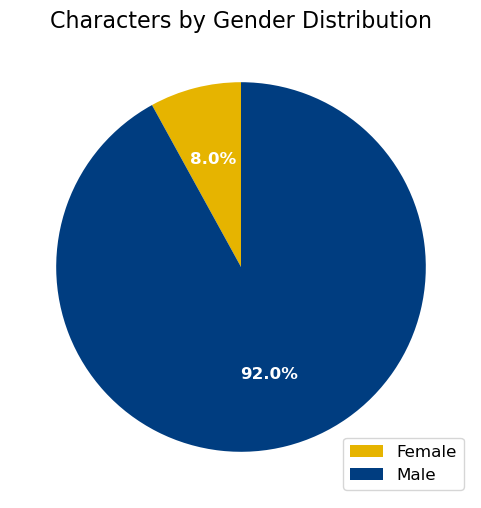

In [20]:
#We are plotting a pie bar to check gender distribution

gender_counts = nodes.groupby('Gender').size()

colors = ['#e6b400', '#003d80']

#We create the pie chart using matplotlib
fig, ax = plt.subplots(figsize=(6, 6))
ax.pie(gender_counts, colors=colors, labels=gender_counts.index, autopct='%1.1f%%', startangle=90, textprops={'color':'white', 'weight':'bold', 'fontsize':12})
ax.set_title('Characters by Gender Distribution', fontsize=16)
ax.legend(loc='lower right', labels=gender_counts.index, fontsize=12)


plt.show()

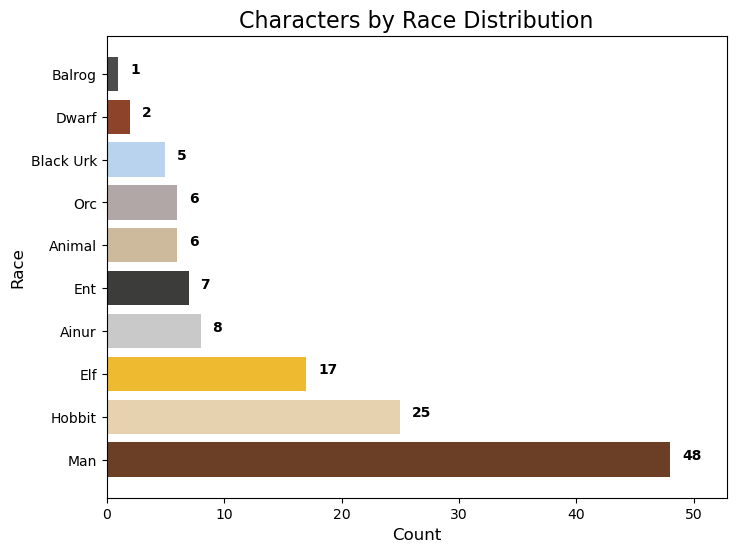

In [21]:
#We will now plot a bar graph for checking Race distribution


#First, we define a color palette based on the Lord of the Rings using Seaborn
palette_lotr = sns.color_palette(['#6B3E26', '#E6D2AF', '#EEBA30', '#C9C9C9', '#3C3C3B', '#CDB99C', '#B1A7A6', '#B9D3EE', '#8D422A', '#4B4B4C'])

#Group the dataframe by race and sort the values in descending order
race_counts = nodes.groupby('Race').size()
race_counts = race_counts.sort_values(ascending=False)

#Create the bar chart
fig, ax = plt.subplots(figsize=(8, 6))
ax.barh(race_counts.index, race_counts.values, color=palette_lotr)
ax.set_xlabel('Count', fontsize=12)
ax.set_ylabel('Race', fontsize=12)
ax.set_title('Characters by Race Distribution', fontsize=16)

#Now, we add total count labels to the right of each bar
for i, v in enumerate(race_counts.values):
    ax.text(v + 1, i, str(v), fontsize=10, fontweight='bold', color='black')

ax.set_xlim(0, max(race_counts.values) * 1.1)


plt.show()

We can see that **most of the characters are male** (there are just 10 females) and that, regarding races, **Man is the most common one**, representing almost a 40% of the total, followed by Hobbits (20%) and Elves (around 14%). 

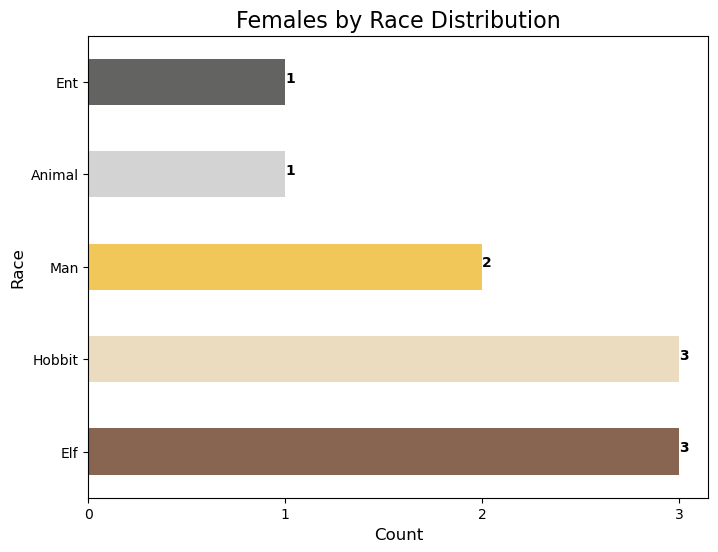

In [22]:
#Now, we are going to plot the same graph but just considering female characters

female_df = nodes[nodes['Gender'] == 'Female']
race_f_counts = female_df.groupby('Race').size()
race_f_counts = race_f_counts.sort_values(ascending=False)

#Create the bar chart
ax = race_f_counts.plot(kind='barh', figsize=(8, 6), color=palette_lotr, alpha=0.8)
ax.set_xlabel('Count', fontsize=12)
ax.set_ylabel('Race', fontsize=12)
ax.set_title('Females by Race Distribution', fontsize=16)
ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))

#Now, we add total count labels to the right of each bar
for i, v in enumerate(race_f_counts.values):
    ax.text(v, i, str(v), fontsize=10, fontweight='bold', color='black')

plt.show()

It can be seen the predominant position of Elves in women representation, with around an 18%. It is followed by Animal, with around a 17%. Now, let's start analyzing the data of the interactions.

In [23]:
#Print the main info of edges
edges.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1105 entries, 0 to 1104
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   From    1104 non-null   object
 1   To      1101 non-null   object
 2   weight  1105 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 26.0+ KB


In [24]:
#Checking for null values in edges
edges.isnull().sum()

From      1
To        4
weight    0
dtype: int64

As we can see, we have 4 null values in "To" and 1 null value in "From". As we need to have both, we are going to drop the rows with nulls. 

In [25]:
#Create a copy of edges
eda_df= edges.copy()

In [26]:
#drop rows with null values in eda_df
eda_df.dropna(inplace=True)

In [27]:
#print the main info of edges
eda_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1100 entries, 0 to 1104
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   From    1100 non-null   object
 1   To      1100 non-null   object
 2   weight  1100 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 34.4+ KB


In [28]:
#We create columns with the names of the characters instead of the index
eda_df['Source'] = eda_df['From'].map(nodes.set_index('Index')['Character'])
eda_df['Recipient'] = eda_df['To'].map(nodes.set_index('Index')['Character'])

In [29]:
#We repeat this process, this time adding the source and recipient race, and the source and recipient genders
eda_df['Source_race'] = eda_df['From'].map(nodes.set_index('Index')['Race'])
eda_df['Recipient_race'] = eda_df['To'].map(nodes.set_index('Index')['Race'])

eda_df['Source_gender'] = eda_df['From'].map(nodes.set_index('Index')['Gender'])
eda_df['Recipient_gender'] = eda_df['To'].map(nodes.set_index('Index')['Gender'])

In [30]:
#Checking the eda_df
eda_df.head()

,From,To,weight,Source,Recipient,Source_race,Recipient_race,Source_gender,Recipient_gender
0,n45,n30,28,Frodo,Elrond,Hobbit,Elf,Male,Male
1,n45,n49,47,Frodo,Gandalf,Hobbit,Ainur,Male,Male
2,n45,n95,21,Frodo,Saruman,Hobbit,Ainur,Male,Male
3,n45,n101,10,Frodo,Theoden,Hobbit,Man,Male,Male
4,n45,n110,29,Frodo,Sauron,Hobbit,Ainur,Male,Male


Now, we have quite an interesting dataframe to try to unfold some insights. Let's go!

In [31]:
#counting the total number of appearances for each character
source_appearances = eda_df['Source'].value_counts()
recipient_appearances = eda_df['Recipient'].value_counts()
total_appearances = pd.concat([source_appearances, recipient_appearances]).groupby(level=0).sum()

#Top 10 characters with the most appearances
print("Top 10 Characters:")
print(total_appearances.nlargest(10))

#Bottom 10 characters with the least appearances
print("Bottom 10 Characters:")
print(total_appearances.nsmallest(10))

Top 10 Characters:
Frodo       99
Aragorn     79
Sauron      71
Bilbo       70
Gandalf     65
Sam         55
Elrond      54
Boromir     43
Denethor    40
Gimli       37
dtype: int64
Bottom 10 Characters:
Angbor                1
Rosie Cotton          1
Willie Banks          2
Asfaloth              3
Beechbone             3
Ceorl                 4
Ghan-buri-Ghan        4
Damrod                5
Barliman Butterbur    6
Goldberry             6
dtype: int64


Not surprise at all, Frodo is the character which more appearances. Is remarkable the presence of Bilbo, despite it is not involved in the plot directly. Also, the presence of Boromir, who dies at the first book. Also, the bottom 10 characters seem pretty logical

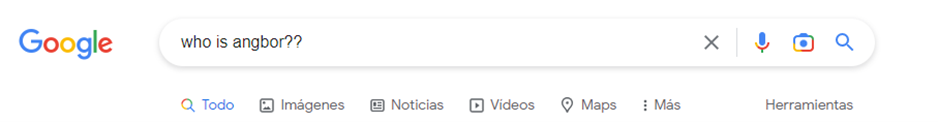

In [32]:
from IPython.display import Image
Image(filename='Images/who_is_angbor.png')

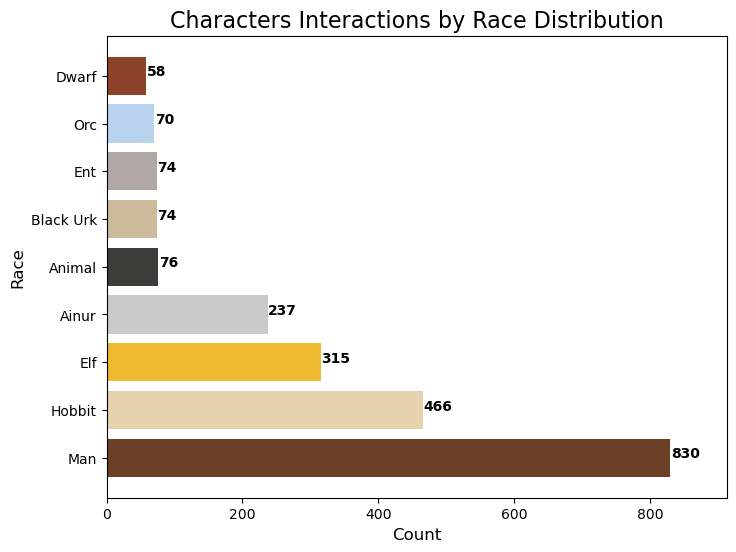

In [33]:
#We will now plot a bar graph for checking Race distribution in interactions

#Create a new df for the races
race_counts_eda = pd.concat([eda_df['Source_race'], eda_df['Recipient_race']]).value_counts()
race_counts_eda = race_counts_eda.sort_values(ascending=False)


#Create the bar chart
fig, ax = plt.subplots(figsize=(8, 6))
ax.barh(race_counts_eda.index, race_counts_eda.values, color=palette_lotr)
ax.set_xlabel('Count', fontsize=12)
ax.set_ylabel('Race', fontsize=12)
ax.set_title('Characters Interactions by Race Distribution', fontsize=16)

for i, v in enumerate(race_counts_eda.values):
    ax.text(v + 1, i, str(v), fontsize=10, fontweight='bold', color='black')

ax.set_xlim(0, max(race_counts_eda.values) * 1.1)

plt.show()

Not relevant changes in relation to the nodes df analysis except at lower terms. It is worthy mentioning that the Ainurs are having much more interactions and weight in the history desite they are not as much as elves, interactions are really simmilar in number

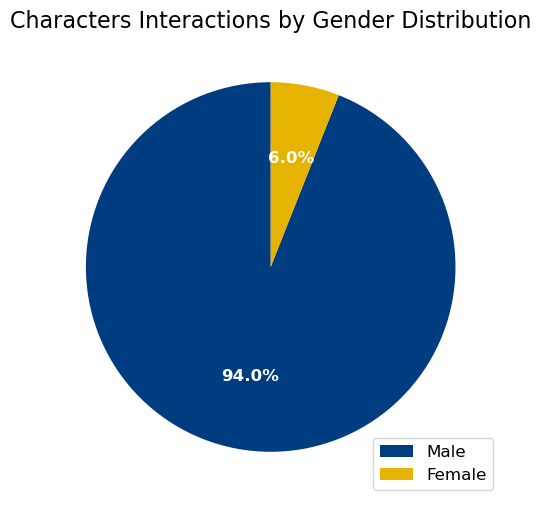

In [34]:
#We are plotting a pie bar to check gender distribution in eda_df
gender_counts_eda = pd.concat([eda_df['Source_gender'], eda_df['Recipient_gender']]).value_counts()

#changing colors order because they were been displaying the other way around
colors = ['#003d80','#e6b400']

#We create the pie chart using matplotlib
fig, ax = plt.subplots(figsize=(6, 6))
ax.pie(gender_counts_eda, colors=colors, labels=gender_counts_eda.index, autopct='%1.1f%%', startangle=90, textprops={'color':'white', 'weight':'bold', 'fontsize':12})
ax.set_title('Characters Interactions by Gender Distribution', fontsize=16)
ax.legend(loc='lower right', labels=gender_counts_eda.index, fontsize=12)


plt.show()

So, it looks like female characters are the lowest in number and also, they have even fewer interactions

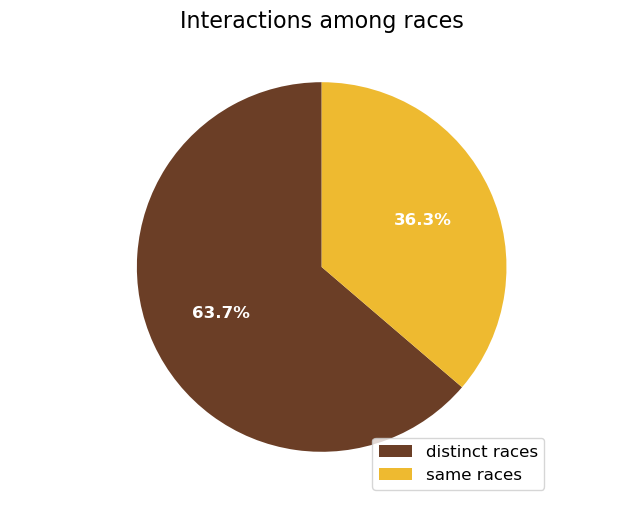

In [35]:
#we want now to analyze if the interactions are more common between same races or between different races

#first, we add a column checking the interaction type
eda_df['Race_relation'] = np.where(eda_df['Source_race'] == eda_df['Recipient_race'], 'same races', 'distinct races')

#then, we count the number of interactions for each type
types_counts = eda_df.groupby('Race_relation').size()

colors = ['#6B3E26', '#EEBA30']

#We create the pie chart using matplotlib
fig, ax = plt.subplots(figsize=(6, 6))
ax.pie(types_counts, colors=colors, labels=types_counts.index, autopct='%1.1f%%', startangle=90, textprops={'color':'white', 'weight':'bold', 'fontsize':12})
ax.set_title('Interactions among races', fontsize=16)
ax.legend(loc='lower right', labels=types_counts.index, fontsize=12)


plt.show()

**Now that's a discovery!** Although it might seem that interactions would be more common between the races themselves, since the inhabitants of Middle Earth are quite suspicious and prejudiced about the different races, the adventure to destroy the ring has put all races in a high degree of interrelation.

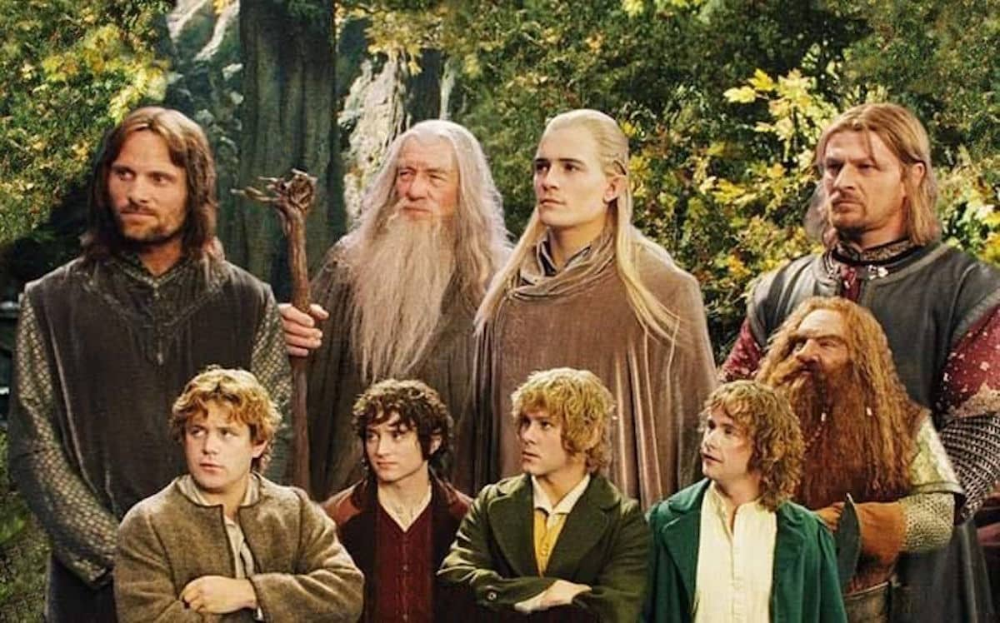

In [36]:
Image(filename='Images/the_fellowship.jpg')

# **3. Creating the Graph and analyzing its metrics**

Our graph analysis will unveil patterns and correlations that might not be immediately apparent, shedding light on the true relations between the characters, and revealing the hidden narrative arcs.

In order to create our Lord Of the Rings graph analysis we have used the book trilogy and by looking at each chapter, we have analyzed the characters interaction. If 2 characters are present in the same chapter, that becomes a connection. We then summed up the number of connections by characters for all the chapters in all 3 books; it becomes then our node's weigths.

The graph is considered undirected as the order of the connection is not a relevant in the relationship definition. There are not node unconnected, making this graph then made of one single component. Let's now create and visualize our graph.

In [37]:
#We are going to create a graph with the weighted edges dataset using networkx
weightededges = pd.read_csv('dataset/weightededges.csv')
weightededges ["From"] = weightededges ["From"].astype(str)
weightededges ["To"] = weightededges ["To"].astype(str)
G = nx.Graph()
G = nx. from_pandas_edgelist(weightededges, source='From',target='To',edge_attr="weight")

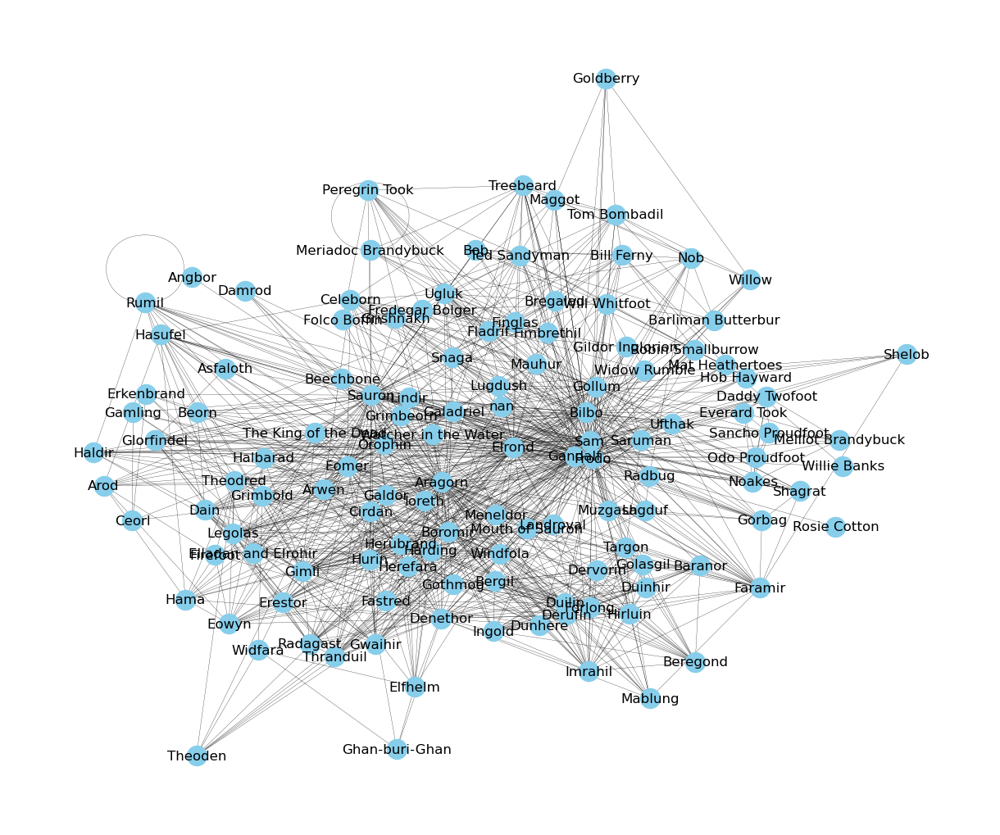

In [38]:
#Now, we are going to plot the graph using matplotlib
plt.figure(figsize=(12,10))
pos = nx.kamada_kawai_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos, width=0.2)
plt.show()

In [39]:
#Lets extract some basic information about the graph structure
print('Number of edges: {}'.format(G.number_of_edges()))
print('Number of nodes: {}'.format(G.number_of_nodes()))
print(f"Eccentricity: {nx.eccentricity(G)}")
print(f"Radius: {nx.radius(G)}")
print(f"Diameter: {nx.diameter(G)}")
print(f"Density: {nx.density(G)}")
print(f"Number of Connected Components: {nx.number_connected_components(G)}")
print(f"Clustering coefficient: {nx.average_clustering(G)}")
print(f"Reciprocity: {nx.overall_reciprocity(G)}")


Number of edges: 1105
Number of nodes: 125
Eccentricity: {'Frodo': 3, 'Elrond': 3, 'Gandalf': 3, 'Saruman': 3, 'Theoden': 2, 'Sauron': 2, 'Bilbo': 2, 'Meriadoc Brandybuck': 3, 'Aragorn': 3, 'Arwen': 3, 'Celeborn': 2, 'Faramir': 3, 'Galadriel': 3, 'Sam': 3, 'Gollum': 3, 'Melilot Brandybuck': 3, 'Noakes': 3, 'Odo Proudfoot': 3, 'Sancho Proudfoot': 3, 'Everard Took': 3, 'Daddy Twofoot': 3, 'Folco Boffin': 3, 'Fredegar Bolger': 3, 'Ted Sandyman': 3, 'Peregrin Took': 3, 'Gildor Inglorion': 3, 'Maggot': 3, 'Tom Bombadil': 3, 'Goldberry': 3, 'Willow': 3, 'Bob': 3, 'Barliman Butterbur': 3, 'Nob': 3, 'Will Whitfoot': 3, 'Bill Ferny': 3, 'Asfaloth': 3, 'Glorfindel': 3, 'Beorn': 2, 'Dain': 3, 'Elladan and Elrohir': 3, 'Grimbeorn': 3, 'Lindir': 3, 'Boromir': 2, 'Cirdan': 2, 'Denethor': 2, 'Erestor': 2, 'Galdor': 2, 'Gimli': 2, 'Gwaihir': 2, 'Hurin': 2, 'Legolas': 2, 'Radagast': 2, 'Thranduil': 2, 'nan': 3, 'Watcher in the Water': 3, 'Haldir': 3, 'Orophin': 3, 'Rumil': 3, 'Arod': 3, 'Eomer': 2, 'Ha

Let's interpretate these data points:

**The number of edges** we have a total of 1105 edges or connections between nodes

**As for the number of nodes** it reaches a total of 125, which equals the number of charactes in the book trilogy previously extracted

**THe Eccentricity** of a node A is defined as the largest distance between A and all other nodes. Basically, it tell us which characters are most central to the newwork. Eccentricity in our graph ranges from  to 4 according to the node we selected.

**The radius of the graph** is the minimum graph eccentricity of any graph node in a graph. In the case of the LOTR graph, it is equal to 2.

**In terms of diameter**, which is the length of the path between the two nodes that are furthest apart our graph path length is **4**. This means that the distance from one end of the network to another or between the two farthest-apart nodes in our network is 4. This could mean that there are some characters who are quite far apart from each other reflecting the fact that the story features multiple sub-groups of characters who are pursuing different goals, such as the Fellowship's quest to destroy the Ring, the battles against Sauron's armies, and the various political machinations taking place in different parts of Middle Earth.

**The density** tell us the ratio of actual edges in the network to all possible edges in the network. In an undirected network like this one, there could be a single edge between any two nodes, but as you saw in the visualization, only a few of those possible edges are actually present. In the Lord of the Rings graph, the density of the network is approximately **0.1425**. On a scale of 0 to 1, not a very dense network. A 0 would mean that there are no connections at all, and a 1 would indicate that all possible edges are present (a perfectly connected network): our network is on the lower end of that scale, but still far from 0. This might reflect the fact that the story takes place in a vast and diverse world with many different cultures and factions. 

**Clustering coefficient** is a measure of how densely connected a node's neighbors are to each other. It can be interpreted as the probability that two nodes, given that they share a common neighbor, will be connected to each other. The clustering coefficient of the LOTR graph is approximately 0.6516, which is relatively high. This suggests that the characters in the story tend to form tightly-knit groups, reflecting the fact that many of the characters are part of larger organizations, such as the Fellowship, the armies of Rohan and Gondor, or the various groups of Elves.

**Reciprocity** is a measure of the extent to which edges in the graph are bidirectional. It is calculated as the ratio of the number of bidirectional edges (edges where A is connected to B and B is connected to A) to the total number of edges in the graph. In the case of the LOTR graph, the reciprocity is 0, which means that there are no bidirectional edges in the graph. This is no a surprise as we have an undirected graph

## 3.1 Centrality Measures: Weighted Degree

Lets now deep-dive into the **centrality** measures, as a way to understand which nodes are the most important ones in our network. No doubt we will see many of our fellowship of the ring members showing up!!!

**Degree** is the simplest and the most common way of finding important nodes. A node’s degree is the sum of its edges. The nodes with the highest degree in a social network are the people who are connected and interact with more people. In this case, we are going to compute the **weighted degree** that is, taking into consideration the weights.

In [40]:
#We are going to calculate weighted degree and link it to the nodes
from operator import itemgetter
degree_dict = dict(G.degree(G.nodes(), weight="weight"))
nx.set_node_attributes(G, degree_dict, 'degree')
sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)

In [41]:
#We are going to print the top 10 nodes by weighted degree
print("Top 10 nodes by degree:")
for d in sorted_degree[:10]:
    print(d)

Top 10 nodes by degree:
('Frodo', 533)
('Sauron', 411)
('Aragorn', 385)
('Sam', 354)
('Gandalf', 352)
('Bilbo', 302)
('Elrond', 285)
('Gimli', 247)
('Legolas', 216)
('Gollum', 173)


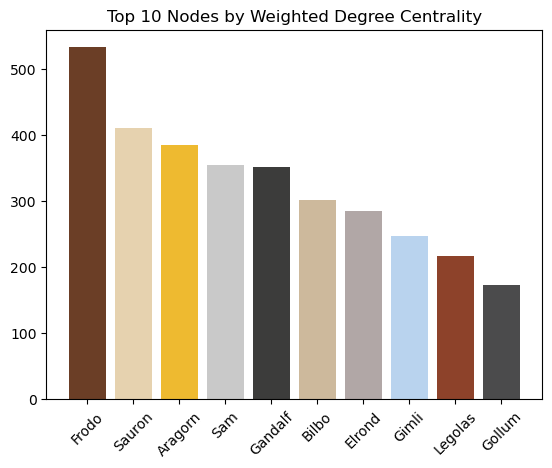

In [42]:
#Create a dataframe from the dictionary an plot the top 10 nodes
degree_df = pd.DataFrame.from_dict(degree_dict, orient='index', columns=['degree'])

#Plot top 10 nodes
top10 = degree_df.sort_values('degree', ascending=False)[0:10]

#This snippet of code is to add our color palette for the bar chart
fig, ax = plt.subplots()
for i, (node, degree) in enumerate(top10.itertuples()):
    ax.bar(node, degree, color=palette_lotr[i])
plt.xticks(rotation=45)

plt.title('Top 10 Nodes by Weighted Degree Centrality')

plt.show()

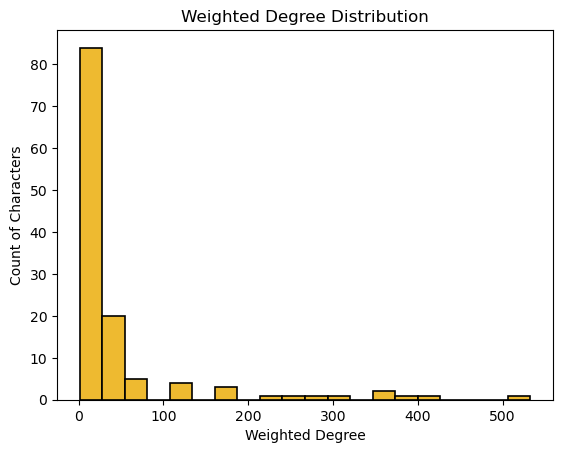

In [43]:
#Plot degree distribution histogram
bins = 20
plt.hist(degree_dict.values(), bins=bins, color=palette_lotr[2], edgecolor='black', linewidth=1.2)
plt.title('Weighted Degree Distribution')
plt.xlabel('Weighted Degree')
plt.ylabel('Count of Characters')
plt.show()

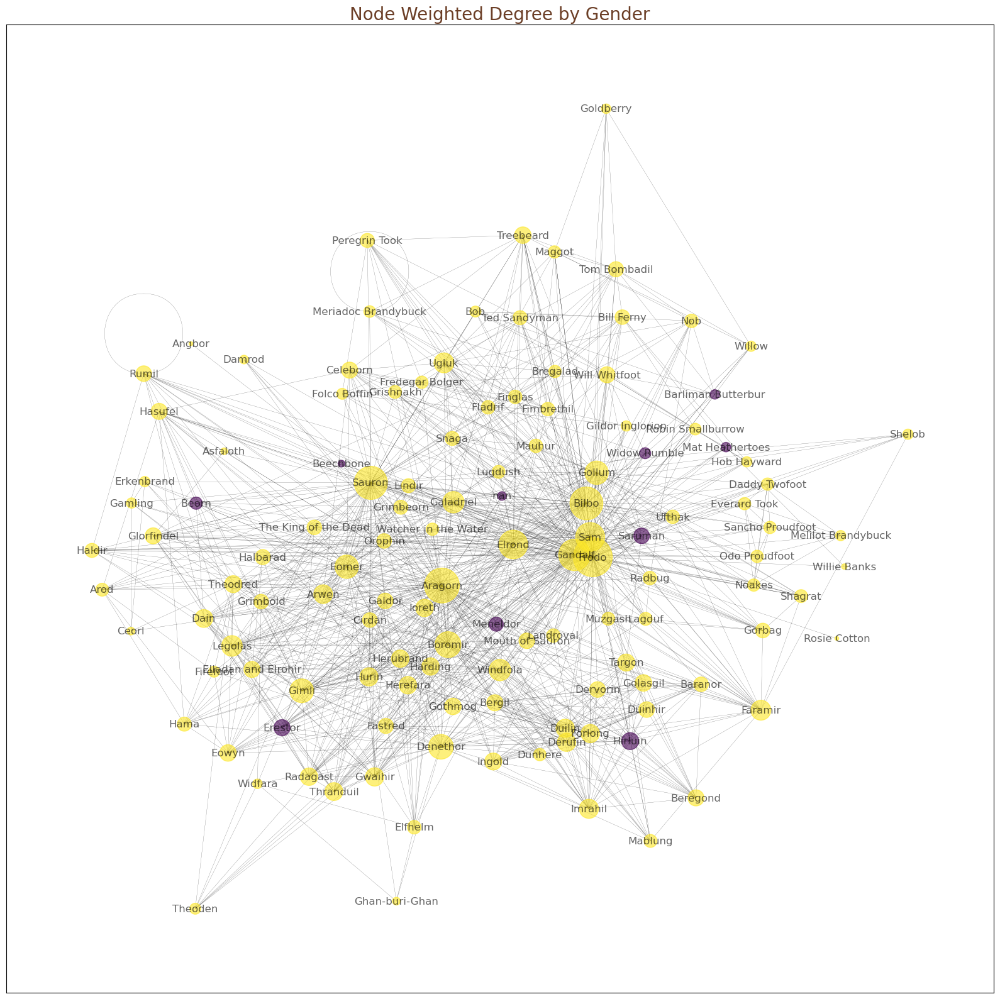

In [44]:
#We are going to plot a graph showing different node color depending on gender and size depending on degree
plt.figure(figsize=(16,16))
plt.title("Node Weighted Degree by Gender", color='#6B3E26', size=20)


pos = nx.kamada_kawai_layout(G)

#Create a dictionary of degrees to use for displaying node sizes by degree
d = dict(G.degree)

#Make types into categories
gend=nodes[['Character', 'Gender']]
gend['Gender'] = pd.Categorical(gend['Gender'])
gend['Gender'].cat.codes

nx.draw_networkx(G, pos = pos,
                 node_color=gend['Gender'].cat.codes,
                 node_size=[v * 20 for v in d.values()],
                 alpha = 0.6, width = 0.2, 
                 with_labels=True)

plt.tight_layout()
plt.show()

As expected, 6 out of the 10 characters with the highest weighted degree belong to the fellowship of the ring. Frodo, the one who carried the One Ring from the Shire to Orodruin, to the very brink of the Cracks of Doom, is in first place with a weighted degree of 533 and is, without doubt, our most important character, as he is the guiding thread.

The second place is for our antagonist Sauron with a weighted degree of 411. Despite is not really interacting with the other characters directly, is always present, acting using others or through the ring.

In third place we find our beloved Aragorn, the descendent of Isildur and King of Arnor and Gondor, with a weighted degree of 385.

Degree can tell us a lot about the biggest nodes, but it can’t tell us that much about the rest of the nodes. And in many cases, those nodes it’s telling us about are not especially surprising. In this case almost all of the nodes are part of the fellowship of the ring.

Finally, based on the degree histogram, vast majority of characters have between 5 and 20  weighted degree.

Now, lets move to other centrality measures to discover more about our network.

## 3.2 Centrality Measures: Eigenvector 

 **Eigenvector centrality** is an of extension of degree. It looks at a combination of a node’s edges and the edges of that node’s neighbors. For eigenvector centrality, it is relevant if a node is important (has a high degree), but it is also relevant how many important nodes are connected to it. It’s calculated as a value from 0 to 1: the closer to one, the greater the centrality. It is useful for understanding which nodes can get information to many other nodes quickly. If you know a lot of well-connected people, you could spread a message very efficiently.

In [45]:
#We are going to calculate eigenvector centrality and link it to the nodes
eigenvector_dict = nx.eigenvector_centrality(G, weight="weight") # Run eigenvector centrality
nx.set_node_attributes(G, eigenvector_dict, 'eigenvector')
sorted_eigenvector = sorted(eigenvector_dict.items(), key=itemgetter(1), reverse=True)

In [46]:
print("Top 10 nodes by eigenvector centrality:")
for e in sorted_eigenvector[:10]:
    print(e)

Top 10 nodes by eigenvector centrality:
('Frodo', 0.41348237651233194)
('Sauron', 0.34355666758413284)
('Sam', 0.33763916791252074)
('Gandalf', 0.29661648786805567)
('Elrond', 0.2671775462614035)
('Bilbo', 0.25829456818469604)
('Gimli', 0.25279256565582353)
('Aragorn', 0.24718279224574033)
('Legolas', 0.2383370231170181)
('Gollum', 0.18682820680181883)


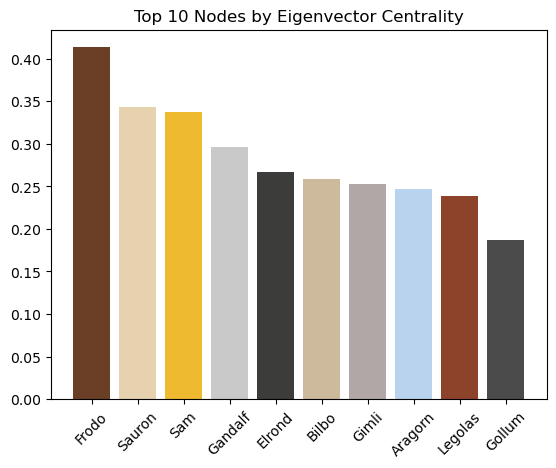

In [47]:
#Create a dataframe from the dictionary and plot the top 10 nodes
eigen_df = pd.DataFrame.from_dict(eigenvector_dict, orient='index', columns=['eigenvector'])
top10 = eigen_df.sort_values('eigenvector', ascending=False)[0:10]

#Plot top 10 nodes
fig, ax = plt.subplots()
for i, (node, eigenvector) in enumerate(top10.itertuples()):
    ax.bar(node, eigenvector, color=palette_lotr[i])
plt.xticks(rotation=45)
plt.title('Top 10 Nodes by Eigenvector Centrality')
plt.show()

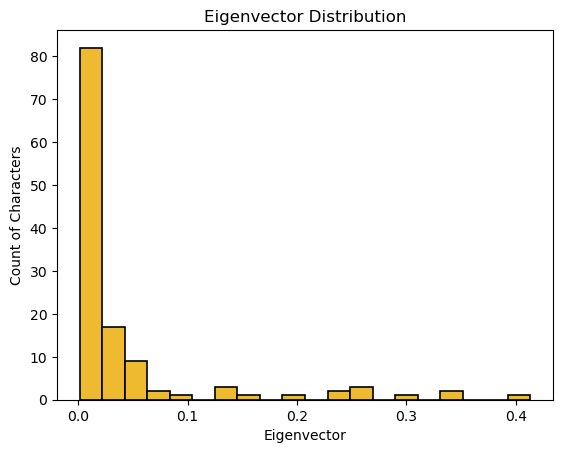

In [48]:
#Plot eigenvector centrality distribution histogram
bins = 20
plt.hist(eigenvector_dict.values(), bins=bins, color='#EEBA30', edgecolor='black', linewidth=1.2)
plt.title('Eigenvector Distribution')
plt.xlabel('Eigenvector')
plt.ylabel('Count of Characters')
plt.show()

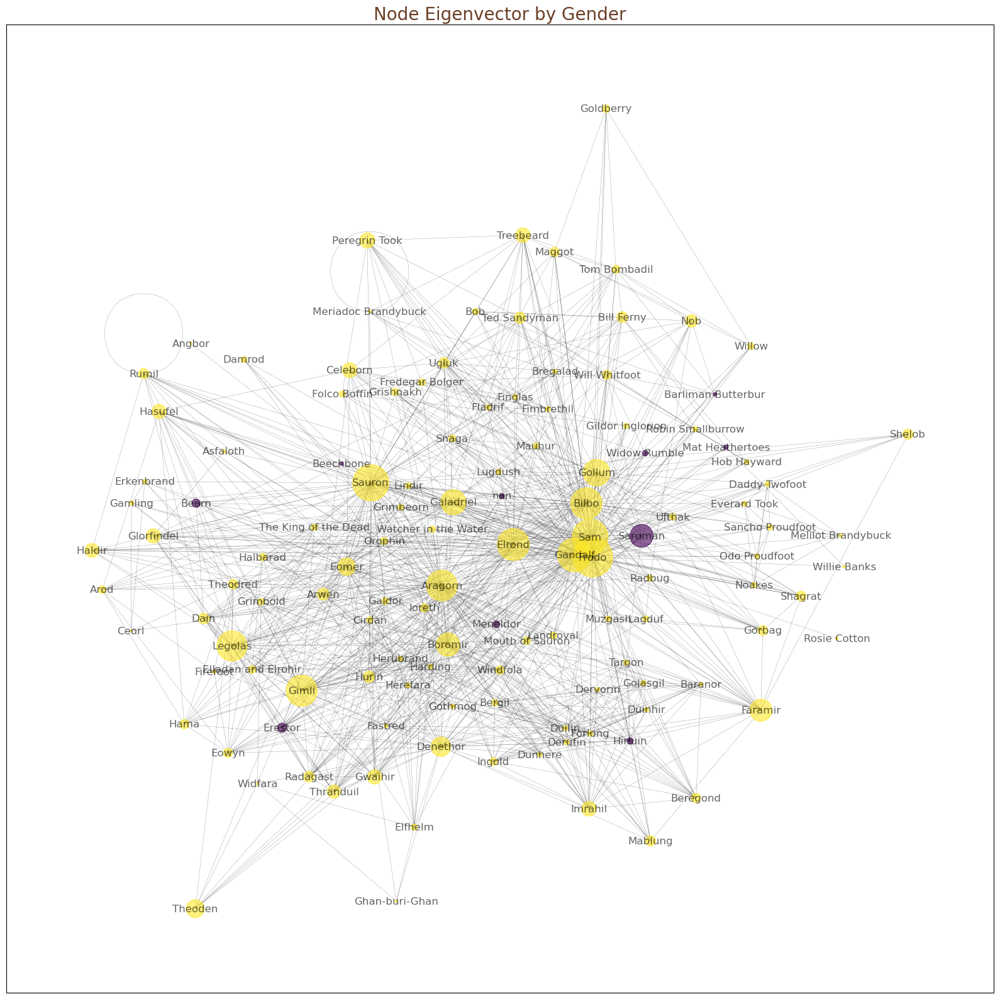

In [49]:
#We are going to plot a graph showing different node color depending on gender and size depending on Eigenvector centrality
plt.figure(figsize=(16,16))
plt.title("Node Eigenvector by Gender", color='#6B3E26', size=20)

pos = nx.kamada_kawai_layout(G)

#Create a dictionary of degrees to use for displaying node sizes by degree
e = dict(nx.eigenvector_centrality(G, weight="weight"))

#Make types into categories
gend=nodes[['Character', 'Gender']]
gend['Gender'] = pd.Categorical(gend['Gender'])
gend['Gender'].cat.codes

nx.draw_networkx(G, pos = pos,
                 node_color=gend['Gender'].cat.codes,
                 node_size=[v * 5000 for v in e.values()],
                 alpha = 0.6, width = 0.2, 
                 with_labels=True)

plt.tight_layout()
plt.show()

The top 3 characters based on eigenvector centrality are Frodo, Sauron, and Sam. These characters have high eigenvector centrality because they have connections with other characters who are also highly connected in the network. For example, Frodo is connected to characters such as Sam, Gandalf, and Aragorn, who are themselves highly connected in the network. This means that Frodo is able to reach a large number of other characters through these connections, which contributes to his high eigenvector centrality.

Aragorn, on the other hand, has a high degree centrality. However, his eigenvector centrality is not as high as the top 3 because he may not be connected to as many other highly connected characters in the network. This means that while Aragorn has many direct connections with other characters, those characters may not themselves be highly connected in the network, which reduces his influence on the flow of information or influence within the network.

Most of characters, as per histogram, have between 0.05 and 0.1 eigenvalue

## 3.3 Centrality Measures: Betweenness 

**Betweenness centrality** is a bit different from the other two measures in that it doesn’t care about the number of edges any one node or set of nodes has. Betweenness centrality looks at all the shortest paths that pass through a particular node. To do this, it must first calculate every possible shortest path in the network. This measure is also expressed on a scale of 0 to 1. Betweenness centrality is a great way of giving us a sense of which nodes are important not because they have lots of connections themselves but because they stand between groups, giving the network connectivity and cohesion.

In [50]:
#We are going to calculate betweenness and link it to the nodes
betweenness_dict = nx.betweenness_centrality(G, weight="weight") # Run betweenness centrality
nx.set_node_attributes(G, betweenness_dict, 'betweenness')
sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)

In [51]:
print("Top 10 nodes by betweenness centrality:")
for b in sorted_betweenness[:10]:
    print(b)

Top 10 nodes by betweenness centrality:
('Frodo', 0.1736689302173019)
('Sauron', 0.11316469002091682)
('Aragorn', 0.07403405548697502)
('Bilbo', 0.07309742099725733)
('Gandalf', 0.05862377506647142)
('Denethor', 0.05791285921615262)
('Elrond', 0.047377759688440095)
('Mouth of Sauron', 0.0353062681791504)
('Boromir', 0.03391380326902249)
('Windfola', 0.032943160842365926)


Text(0.5, 1.0, 'Top 10 Nodes by Betweenness Centrality')

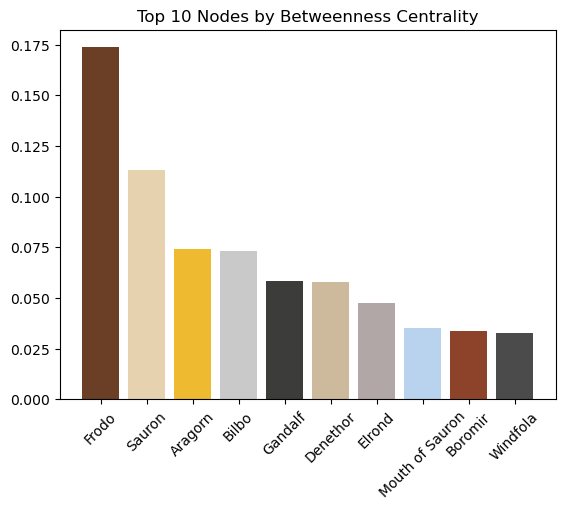

In [52]:
#Create a dataframe from the dictionary and plot the top 10 nodes
betweenness_df = pd.DataFrame.from_dict(betweenness_dict, orient='index', columns=['betweenness'])
top10 = betweenness_df.sort_values('betweenness', ascending=False)[0:10]

#Plot top 10 nodes
fig, ax = plt.subplots()
for i, (node, betweenness) in enumerate(top10.itertuples()):
    ax.bar(node, betweenness, color=palette_lotr[i])
plt.xticks(rotation=45)

plt.title('Top 10 Nodes by Betweenness Centrality')

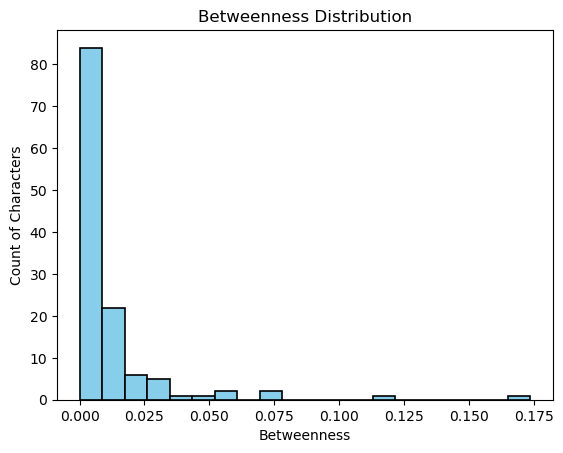

In [53]:
#Plot betweenness distribution histogram
bins = 20
plt.hist(betweenness_dict.values(), bins=bins, color='skyblue', edgecolor='black', linewidth=1.2)
plt.title('Betweenness Distribution')
plt.xlabel('Betweenness')
plt.ylabel('Count of Characters')
plt.show()

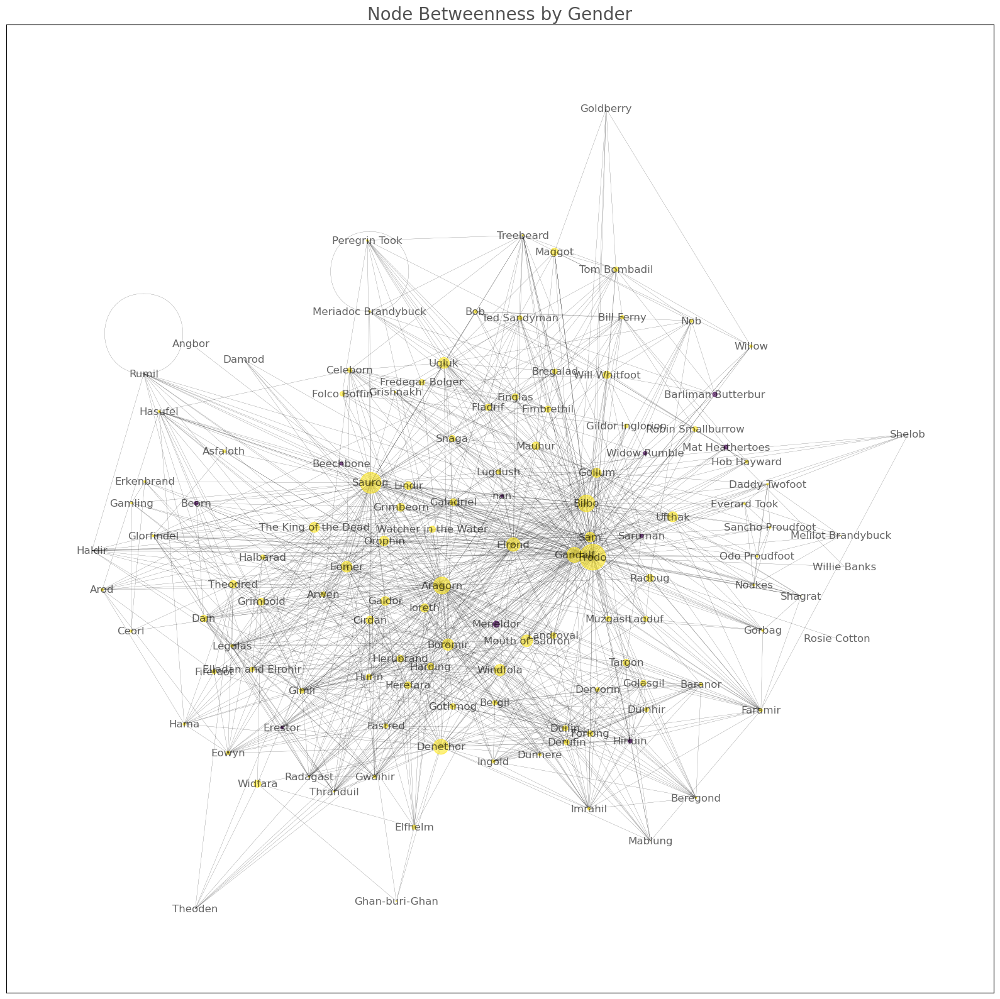

In [54]:
#We are going to plot a graph showing different node color depending on gender and size depending on betweenness
plt.figure(figsize=(16,16))
plt.title("Node Betweenness by Gender", color='#525252', size=20)


pos = nx.kamada_kawai_layout(G)

#Create dictionary of degrees to use for displayind node sizes by degree
b = dict(nx.betweenness_centrality(G, weight="weight"))

# Make types into categories
gend=nodes[['Character', 'Gender']]
gend['Gender'] = pd.Categorical(gend['Gender'])
gend['Gender'].cat.codes

nx.draw_networkx(G, pos = pos,
                 node_color=gend['Gender'].cat.codes,
                 node_size=[v * 5000 for v in b.values()],
                 alpha = 0.6, width = 0.2, 
                 with_labels=True)

plt.tight_layout()
plt.show()

Many, but not all, of the nodes that have high degree also have high betweenness centrality. In fact, betweeness centrality surfaces certain characters that we will like to mention:

**Denethor**, with a betweenness centrality of 0.057, plays an important role in connecting different groups of characters. As the Steward of Gondor, he is connected to several key characters in the story, such as Boromir and Faramir, and is involved in several key events, such as the Battle of Minas Tirith. Denethor's position as a central figure in the Gondorian government makes him a key player in transmitting information or influence between different groups of characters, which contributes to his high betweenness centrality.

**Elrond**, with a betweenness centrality of 0.047, acts as a bridge between several characters in the network. He has connections with several key characters, including Arwen, Gandalf, and Aragorn, and is also involved in some of the major events in the story, such as the Council of Elrond. As a result, Elrond is often involved in transmitting information or influence between different groups of characters, which increases his betweenness centrality.


**Windfola**, with a betweenness centrality of 0.033, is a less well-known character in the story but still plays an important role in connecting different characters. Windfola is the horse that Aragorn rides during his pursuit of the Uruk-hai who have taken Merry and Pippin. As a result, Windfola becomes a key figure in connecting Aragorn to other characters in the story, such as Eomer and Theoden, who are involved in the pursuit of the Uruk-hai. This increases Windfola's betweenness centrality, despite the fact that Windfola is not a major character in the story.

Most of the characters have trully low betweenness centrality, less than 0.05

## 3.4 Centrality Measures: Closeness

**Closeness centrality** is based on the assumption that important nodes are close to other nodes. This measure calculates the shortest paths between all nodes, then assigns each node a score based on its sum of shortest paths. It is useful for finding the characters who are best placed to influence the entire network most quickly.

In [55]:
#We are going to calculate betweenness and link it to the nodes
close_dict = nx.closeness_centrality(G) # Run closenness centrality
nx.set_node_attributes(G, close_dict, 'closeness')
sorted_closeness = sorted(close_dict.items(), key=itemgetter(1), reverse=True)

In [56]:
print("Top 10 nodes by closeness centrality:")
for c in sorted_closeness[:10]:
    print(c)

Top 10 nodes by closeness centrality:
('Frodo', 0.8322147651006712)
('Aragorn', 0.7294117647058823)
('Sauron', 0.7045454545454546)
('Bilbo', 0.7005649717514124)
('Gandalf', 0.6739130434782609)
('Elrond', 0.6358974358974359)
('Sam', 0.6358974358974359)
('Boromir', 0.6078431372549019)
('Denethor', 0.5961538461538461)
('Gimli', 0.5876777251184834)


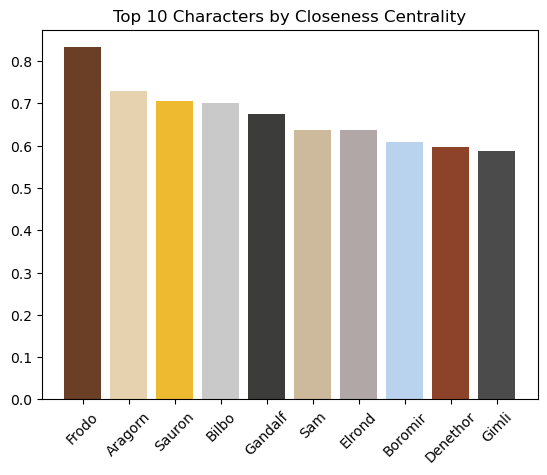

In [57]:
#Create a dataframe from the dictionary an plot the top 10 nodes
close_df = pd.DataFrame.from_dict(close_dict, orient='index', columns=['closeness'])

#Plot top 10 nodes
top10 = close_df.sort_values('closeness', ascending=False)[0:10]

#This snippet of code is to add our color palette for the bar chart
fig, ax = plt.subplots()
for i, (node, closeness) in enumerate(top10.itertuples()):
    ax.bar(node, closeness, color=palette_lotr[i])
plt.xticks(rotation=45)

plt.title('Top 10 Characters by Closeness Centrality')

plt.show()

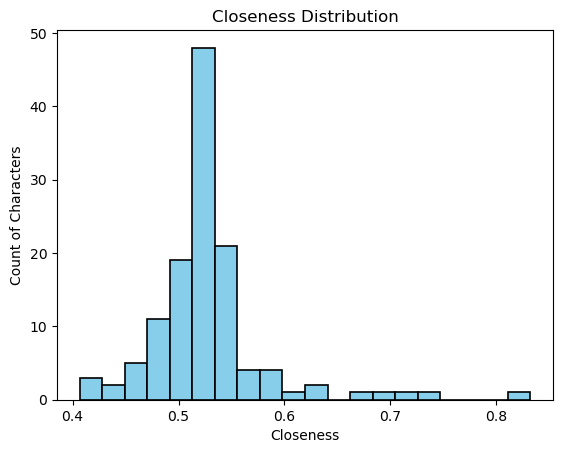

In [58]:
#Plot betweenness distribution histogram
bins = 20
plt.hist(close_dict.values(), bins=bins, color='skyblue', edgecolor='black', linewidth=1.2)
plt.title('Closeness Distribution')
plt.xlabel('Closeness')
plt.ylabel('Count of Characters')
plt.show()

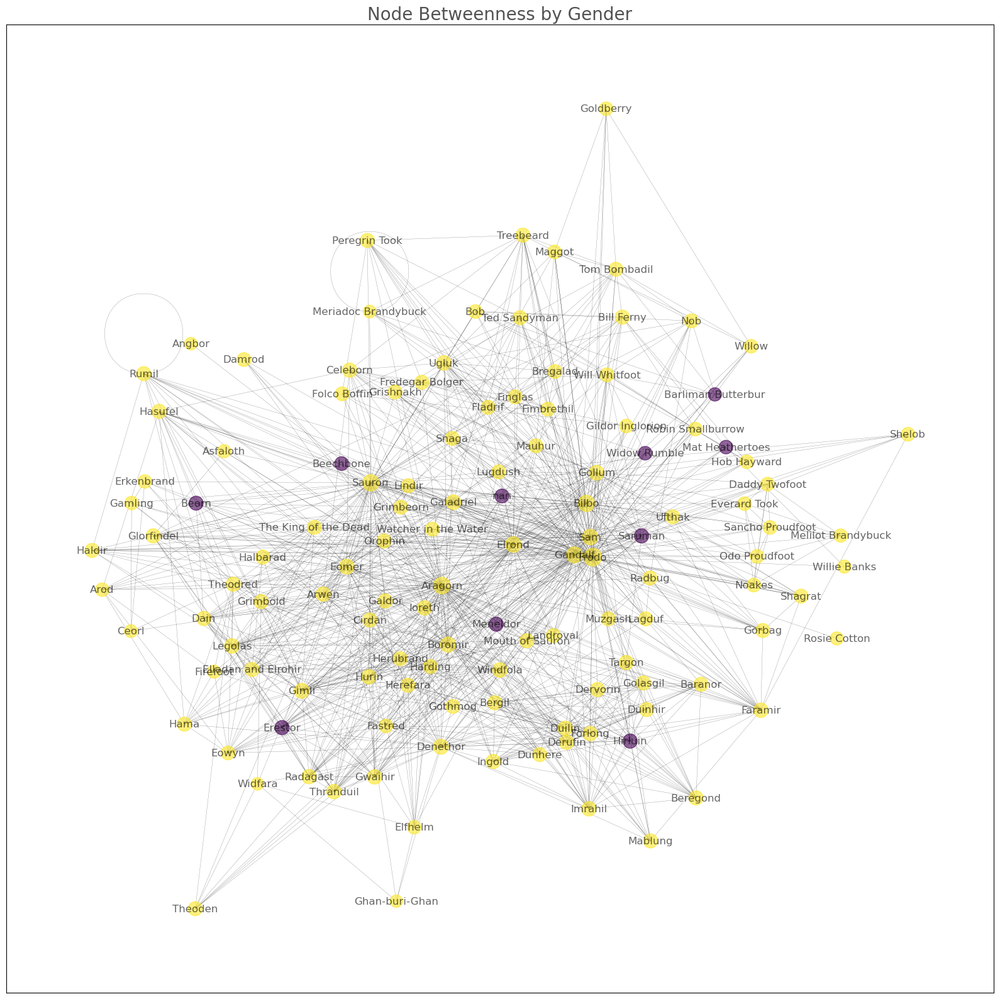

In [59]:
#We are going to plot a graph showing different node color depending on gender and size depending on closeness
plt.figure(figsize=(16,16))
plt.title("Node Betweenness by Gender", color='#525252', size=20)


pos = nx.kamada_kawai_layout(G)

# create dictionary of degrees to use for displaying node sizes by degree
c = dict(nx.closeness_centrality(G))

# Make types into categories
gend=nodes[['Character', 'Gender']]
gend['Gender'] = pd.Categorical(gend['Gender'])
gend['Gender'].cat.codes

nx.draw_networkx(G, pos = pos,
                 node_color=gend['Gender'].cat.codes,
                 node_size=[v * 500 for v in c.values()],
                 alpha = 0.6, width = 0.2, 
                 with_labels=True)

plt.tight_layout()
plt.show()

No surprises, <b> Frodo, Aragorn and Sauron rank first</b>, second and thrid on the closeness centrality metric. Most of the characters have very low closeness centrality, except for a few above 0.5 

## 3.5 Correlation between Centrality Measures

With regards of correlation among these centralty metrics, most of these measures are highly correlated, meaning they don’t necessarily capture unique aspects of the graph. However, the amount of correlation depends on the network structure. Below, a heatmap with correlation values between them. 

In [60]:
df = pd.concat([degree_df, eigen_df, betweenness_df, close_df], axis=1)

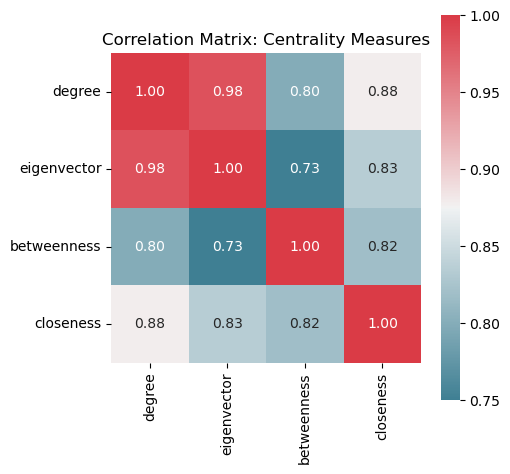

In [61]:
#correlation matrix
corr = df.corr()
plt.figure(figsize=(5,5))
sns.heatmap(corr,
    cmap=sns.diverging_palette(220, 10, as_cmap=True),
    vmin=0.75, vmax=1.0,
    square=True, annot = True, fmt='.2f',)

plt.title('Correlation Matrix: Centrality Measures')
plt.show()

Checking the correlation matrix, we can easily find out that **weighted degree and eigenvalue are really correlated measures**. Despite that, the other measures more focused in path distance are not as much correlated, so the whole analysis performed here will provide us with valuable insights and cover many different aspects.

# **4. Communities Detection**

Are relationships in Middle-Earth segmented based on race? We have seen in the previous EDA that despite Middle-Earth inhabitants are suspicious about other races, the interactions between races are the main rule... But are they forming communities that interact between themselves based on race? Let's find it out with our community detection analysis.

We are going to leverage different algorithms and compare results

## 4.1. The Girvan-Newman algorithm 

This algorithm detects communities by progressively removing edges from the original network. It relies on the iterative elimination of edges that have the highest number of shortest paths between nodes passing through them. By removing edges from the graph one-by-one, the network breaks down into smaller pieces, so-called communities. The algorithm was introduced by Michelle Girvan and Mark Newman.

In [62]:
#Calculating the Girvan–Newman algorithm
communities = nx.community.girvan_newman(G)
 
node_groups = []
for com in next(communities):
    node_groups.append(list(com))
    
print(node_groups)


[['The King of the Dead', 'Fladrif', 'Gamling', 'Meneldor', 'Mauhur', 'Theoden', 'Grimbeorn', 'Mablung', 'Ted Sandyman', 'Hurin', 'Lugdush', 'Erkenbrand', 'Meriadoc Brandybuck', 'Asfaloth', 'Everard Took', 'Halbarad', 'Firefoot', 'Ghan-buri-Ghan', 'Herubrand', 'Glorfindel', 'Widfara', 'Dain', 'Finglas', 'Galdor', 'Ingold', 'Cirdan', 'Elladan and Elrohir', 'Ufthak', 'Eowyn', 'Radbug', 'Gwaihir', 'Willie Banks', 'Odo Proudfoot', 'Mat Heathertoes', 'Beregond', 'Aragorn', 'Ugluk', 'Hob Hayward', 'Rumil', 'Willow', 'Sam', 'Folco Boffin', 'Melilot Brandybuck', 'Orophin', 'Elrond', 'Mouth of Sauron', 'Beechbone', 'Sauron', 'Gimli', 'Targon', 'Celeborn', 'Fimbrethil', 'Erestor', 'Lagduf', 'Muzgash', 'Robin Smallburrow', 'Boromir', 'Baranor', 'Shelob', 'Gorbag', 'Beorn', 'Bill Ferny', 'Thranduil', 'Sancho Proudfoot', 'Watcher in the Water', 'Ioreth', 'Lindir', 'Dunhere', 'Daddy Twofoot', 'Arwen', 'Imrahil', 'Arod', 'Hirluin', 'Derufin', 'Widow Rumble', 'Maggot', 'Galadriel', 'Theodred', 'Tom Bo

1


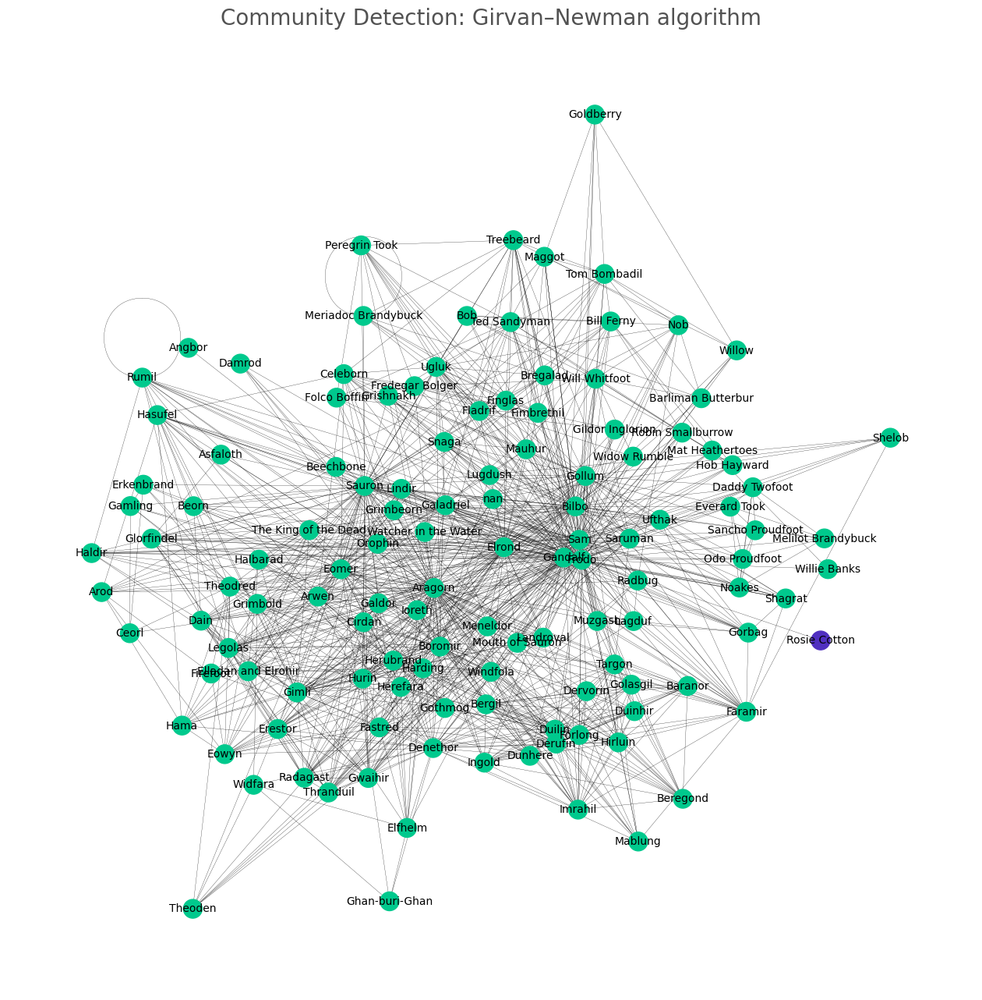

In [63]:
#Community visualization
plt.figure(figsize=(16,16))
plt.title("Community Detection: Girvan–Newman algorithm", color='#525252', size=20)
colors = ["#00C98D", "#5030C0", "#50F0F0"]
pos = nx.kamada_kawai_layout(G)
lst_b = nx.community.girvan_newman(G)
color_map_b = {}
keys = G.nodes()
values = "black"
for i in keys:
        color_map_b[i] = values
counter = 0
for x in lst_b:
  print(1)
  for c in x:
    for n in c:
      #print(n,counter)
      color_map_b[n] = colors[counter]
    counter = counter + 1
  break
nx.draw_networkx_edges(G, pos,width=0.2)
nx.draw_networkx_nodes(G, pos, node_color=dict(color_map_b).values())
nx.draw_networkx_labels(G, pos, font_size=10, font_family="sans-serif")
plt.axis("off")
plt.show()

Our Girvan-Newman algorithm is just returning a single community. This can happen when the algorithm is able to find a single connected component in the graph or if there are only a few edges between communities that the algorithm is not able to detect. When we have used the itertools package as explained in the documentation (https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.community.centrality.girvan_newman.html). We were just getting one large component and as many separated nodes as communities indicated in k

## 4.2. Louvain Algorithm

The Louvain algorithm is another community detection algorithm that works by optimizing a modularity score, which measures the density of edges within communities relative to the density of edges between communities. The algorithm starts by assigning each node to its own community, and then iteratively merges communities that increase the modularity score. This process is repeated until the modularity score can no longer be improved.

In [64]:
communities = nx.community.louvain_communities(G, weight='weight')

for community in communities:
    print(community)

{'Glorfindel', 'Fladrif', 'Saruman', 'Elrond', 'Finglas', 'Mauhur', 'Theoden', 'Sauron', 'Lugdush', 'Ugluk', 'Fimbrethil', 'Meriadoc Brandybuck', 'Asfaloth', 'Snaga', 'Grishnakh', 'Bregalad', 'Angbor', 'Peregrin Took', 'Gandalf', 'Treebeard'}
{'Arod', 'The King of the Dead', 'Dain', 'Gamling', 'Eomer', 'Meneldor', 'Orophin', 'Beechbone', 'Galdor', 'Hama', 'Gimli', 'Haldir', 'Mablung', 'Cirdan', 'Legolas', 'Hurin', 'nan', 'Eowyn', 'Gwaihir', 'Thranduil', 'Landroval', 'Theodred', 'Erkenbrand', 'Aragorn', 'Watcher in the Water', 'Damrod', 'Erestor', 'Ceorl', 'Rumil', 'Hasufel', 'Boromir', 'Denethor', 'Firefoot', 'Radagast'}
{'Sam', 'Folco Boffin', 'Melilot Brandybuck', 'Ted Sandyman', 'Widow Rumble', 'Maggot', 'Galadriel', 'Celeborn', 'Tom Bombadil', 'Lagduf', 'Everard Took', 'Faramir', 'Muzgash', 'Robin Smallburrow', 'Rosie Cotton', 'Barliman Butterbur', 'Shagrat', 'Shelob', 'Gorbag', 'Noakes', 'Frodo', 'Bill Ferny', 'Nob', 'Bilbo', 'Will Whitfoot', 'Bob', 'Ufthak', 'Radbug', 'Willie Ban

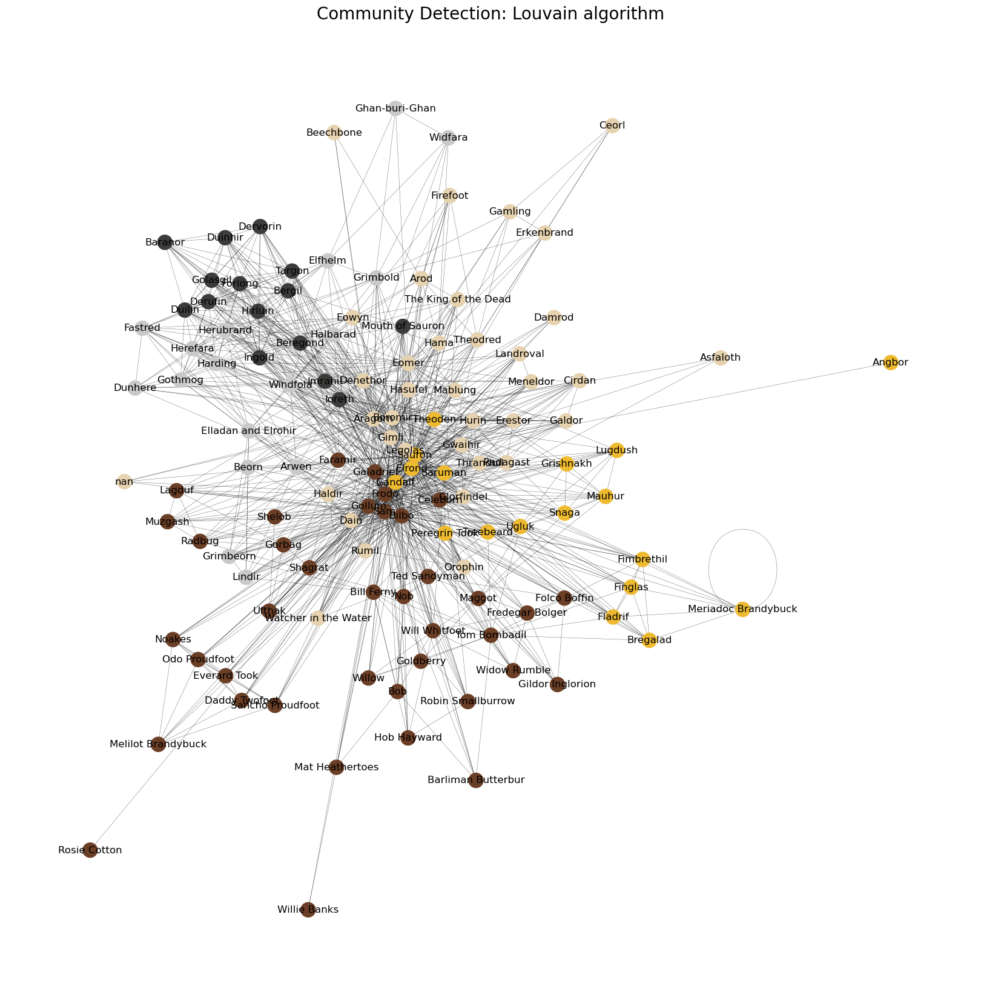

In [65]:
COLORS = palette_lotr
plt.figure(figsize=(16,16))
def get_index(node, node_groups):
    i = 0
    while(i<len(node_groups)):
        if node in node_groups[i]:
            return i
        else:
            i+=1
    return -1


communities = sorted(nx.community.louvain_communities(G, weight='weight'), key=len, reverse=True)

color_map = []

for node in G:
    index = get_index(node, communities)
    if(index >= len(COLORS)):
        print("More groups than colors; add some more colors.")
        break
    if(index == -1):
        print("Node note in a community")
        break
    color_map.append(COLORS[index])

nx.draw(G, node_color=color_map, with_labels=True, width=0.2)
plt.title("Community Detection: Louvain algorithm",fontsize=20)
plt.show()

This is a most interesting output!! We have a total of 5 communities. Just to mention one interesting fact, the members of the Fellowship of the ring are completely split between communities. Frodo and Sam are in the community one (dark brown in our plot). Legolas, Aragorn, Boromir and Gimli are in community 2 (light gold). Gandalf is alone, just with the most powerful characters of the plot. Merry and Pippin are in other community also. Despite this can seem weird, it makes sense based on the subplots that we all the fans know

## 4.3. The Clauset-Newman-Moore (CNM) Algorithm

The aim of this algorithm, in general, is to partition nodes into communities so that the observed density of connections within communities is maximally greater than what we would expect had the network been generated under some null connectivity model.

In [66]:
#Find the communities
communities = sorted(nx.community.greedy_modularity_communities(G), key=len, reverse=True)

#Count the communities
print(f"The Lord of the Rings has {len(communities)} communities.")

The Lord of the Rings has 3 communities.


In [67]:
#We define a function that adds a community attribute to each node
def set_node_community(G, communities):
    '''Add community to node attributes'''
    for c, v_c in enumerate(communities):
        for v in v_c:
            # Add 1 to save 0 for external edges
            G.nodes[v]['community'] = c + 1

#We define a function that adds a community attribute to each edge   
def set_edge_community(G):
    '''Find internal edges and add their community to their attributes'''
    for v, w, in G.edges:
        if G.nodes[v]['community'] == G.nodes[w]['community']:
            # Internal edge, mark with community
            G.edges[v, w]['community'] = G.nodes[v]['community']
        else:
            # External edge, mark as 0
            G.edges[v, w]['community'] = 0

#Assign a unique color to each vertex based on its community   
def get_color(i, r_off=1, g_off=1, b_off=1):
    '''Assign a color to a vertex.'''
    r0, g0, b0 = 0, 0, 0
    n = 16
    low, high = 0.1, 0.9
    span = high - low
    r = low + span * (((i + r_off) * 3) % n) / (n - 1)
    g = low + span * (((i + g_off) * 5) % n) / (n - 1)
    b = low + span * (((i + b_off) * 7) % n) / (n - 1)
    return (r, g, b)

In [68]:
#Set node and edge communities
set_node_community(G, communities)
set_edge_community(G)
node_color = [get_color(G.nodes[v]['community']) for v in G.nodes]

#Set community color for edges between members of the same community (internal) and intra-community edges (external)
external = [(v, w) for v, w in G.edges if G.edges[v, w]['community'] == 0]
internal = [(v, w) for v, w in G.edges if G.edges[v, w]['community'] > 0]
internal_color = ['black' for e in internal]

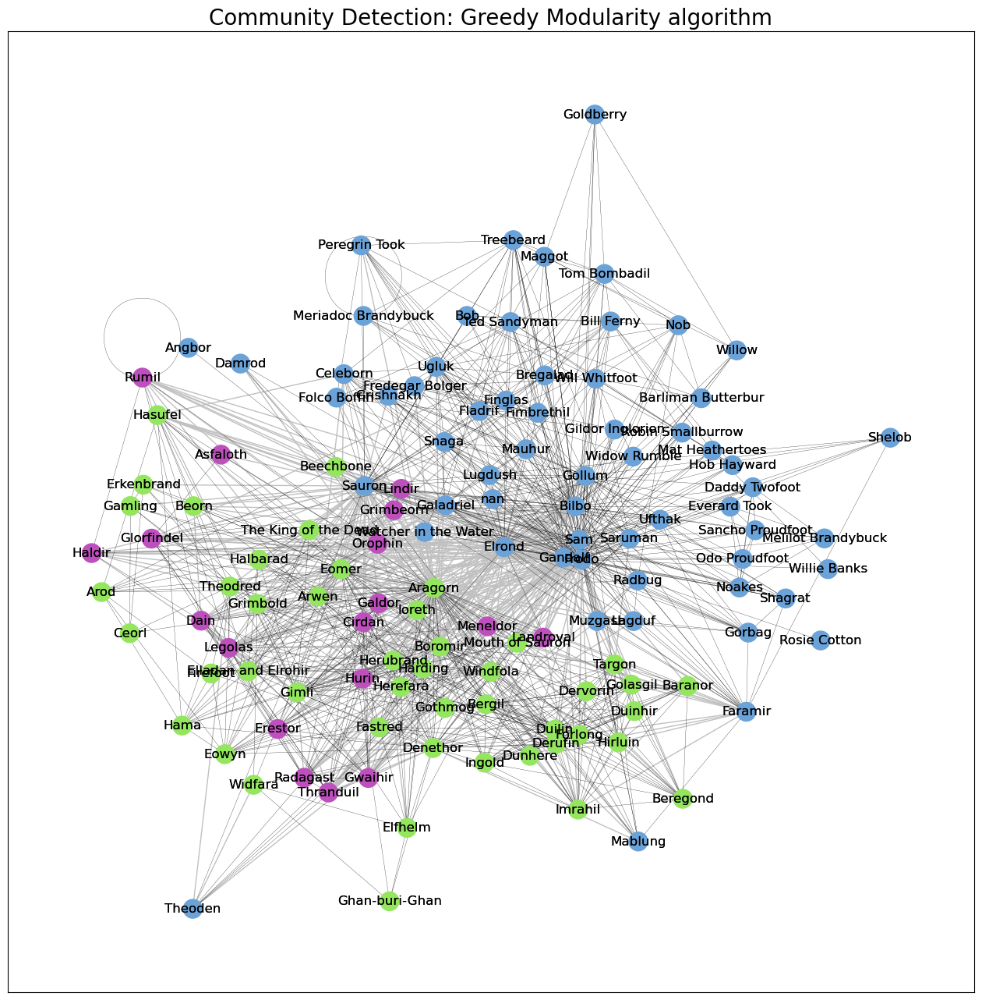

In [69]:
pos = nx.kamada_kawai_layout(G)
plt.rcParams.update({'figure.figsize': (16, 16)})

#Draw external edges
nx.draw_networkx(
    G,
    pos=pos,
    node_size=0,
    edgelist=external,
    edge_color="silver")

#Draw nodes and internal edges
nx.draw_networkx(
    G,
    pos=pos,
    node_color=node_color,
    edgelist=internal,
    edge_color=internal_color,
    width=0.2)
plt.title("Community Detection: Greedy Modularity algorithm",fontsize=20)
plt.show()



With the Clauset-Newman-Moore (CNM) Algorithm we have found three communities. The reader can go through them and try to unfold some facts. Just one interesting thing. In this graph, Legolas is completely separated of the members of the fellowship and included in a community mostly conformed by elves!

# 5. Information Diffusion

In the world of Middle-earth, information diffusion plays a crucial role in shaping the fate of nations and characters alike. From the spreading of news and rumors through the taverns of Bree, to the covert whispers of the Dark Lord's spies, the dissemination of information is a powerful force that can sway the tides of war. Understanding the dynamics of information diffusion in the Lord of the Rings can provide us with valuable insights into the ways in which information shapes the behavior and decisions of the story's characters. By analyzing the spread of information in Middle-earth, we can uncover the roles of key influencers, such as Gandalf and Saruman, and understand the impact of information on the story's major plot points. So let us journey forth, and explore the intricate web of information diffusion that weaves its way throughout the Lord of the Rings, and gain a deeper understanding 

Leveraging the **Independent Cascade Model- ICM**, a stochastic information diffusion model where the information flows over the network through cascade. Nodes can have two states:

(i) Active: It means the node already influenced by the information in diffusion.

(ii) Inactive: node unaware of the information or not influenced.

The process runs in discrete steps. At the beginning of ICM process, few nodes are given the information known as seed nodes. Upon receiving the information these nodes become active. In each discrete step, an active node tries to influence one of its inactive neighbors. In spite of its success, the same node will never get another chance to activate the same inactive neighbor. The success depends on the propagation probability of their tie. Propagation Probability of a tie is the probability by which one can influence the other node. For this exercise we are going to use weight as the propagation probability

In [70]:
# Defining helpful functions
def independent_cascade(G,t,infection_times):
    #doing a t->t+1 step of independent_cascade simulation
    #each infectious node infects neigbors with probabilty proportional to the weight
    max_weight = max([e[2]['weight'] for e in G.edges(data=True)])
    current_infectious = [n for n in infection_times if infection_times[n]==t]
    for n in current_infectious:
        for v in G.neighbors(n):
            if v not in infection_times:
                if  G.get_edge_data(n,v)['weight'] >= np.random.random()*max_weight:
                    infection_times[v] = t+1
    return infection_times

def plot_G(G,pos,infection_times,t):
    current_infectious = [n for n in infection_times if infection_times[n]==t]
    plt.rcParams['figure.facecolor'] = 'black'
    plt.figure()
    plt.axis('off')
    plt.title('Lord of the Rings Network, t={}'.format(t),fontsize = 24)

    for node in G.nodes():
        size = 100*degree_dict[node]**0.5
        if node in current_infectious:
            ns = nx.draw_networkx_nodes(G,pos,nodelist=[node], node_size=size, node_color='#feba02')
        elif infection_times.get(node,9999999)<t:
            ns = nx.draw_networkx_nodes(G,pos,nodelist=[node], node_size=size, node_color='#f2f6fa')
        else:
            ns = nx.draw_networkx_nodes(G,pos,nodelist=[node], node_size=size, node_color='#009fe3')
        ns.set_edgecolor('#f2f6fa')
    nx.draw_networkx_labels(G,pos,{n:n.replace('-','\n') for n in G.nodes() if degree_dict[n]>100},font_size=10);

    for e in G.edges(data=True):
        if e[2]['weight']>10:
            nx.draw_networkx_edges(G,pos,[e],width=e[2]['weight']/100,edge_color='#FFFFFF',alpha=1)

In [71]:
infection_times = {'Rosie Cotton':-1, 'Sam':0}

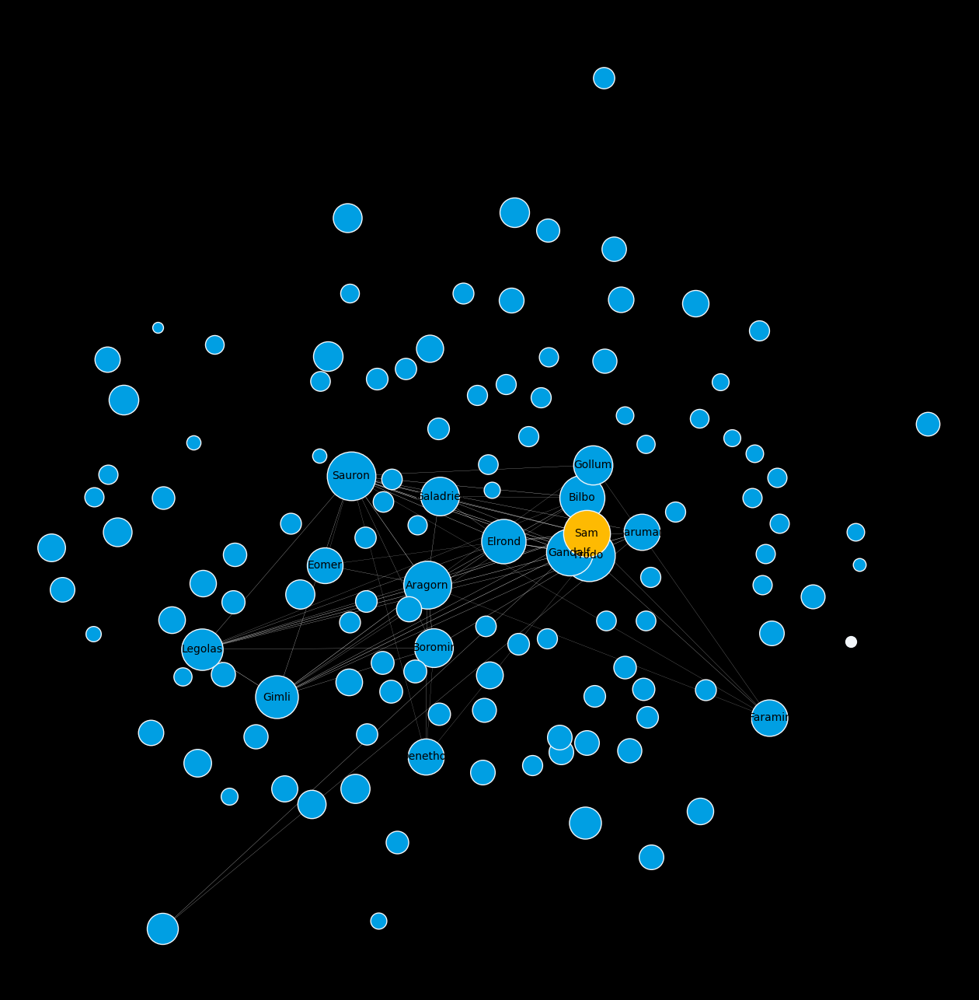

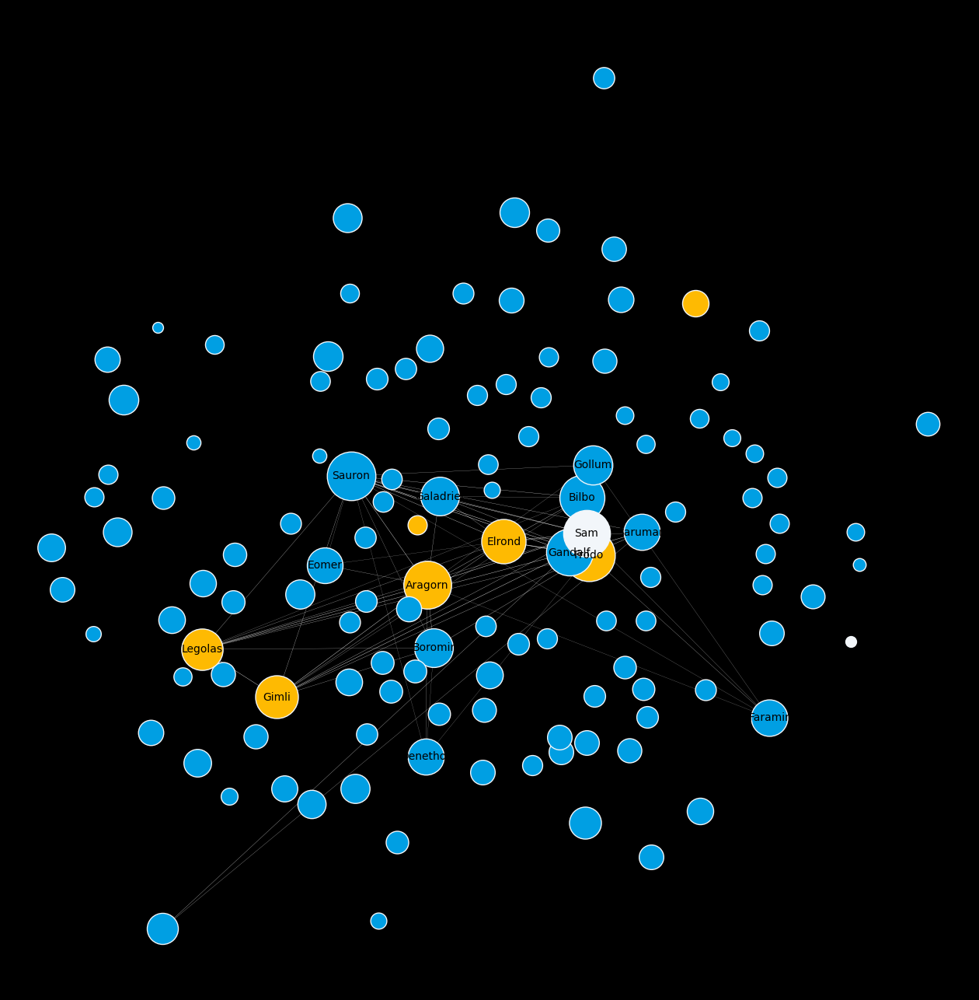

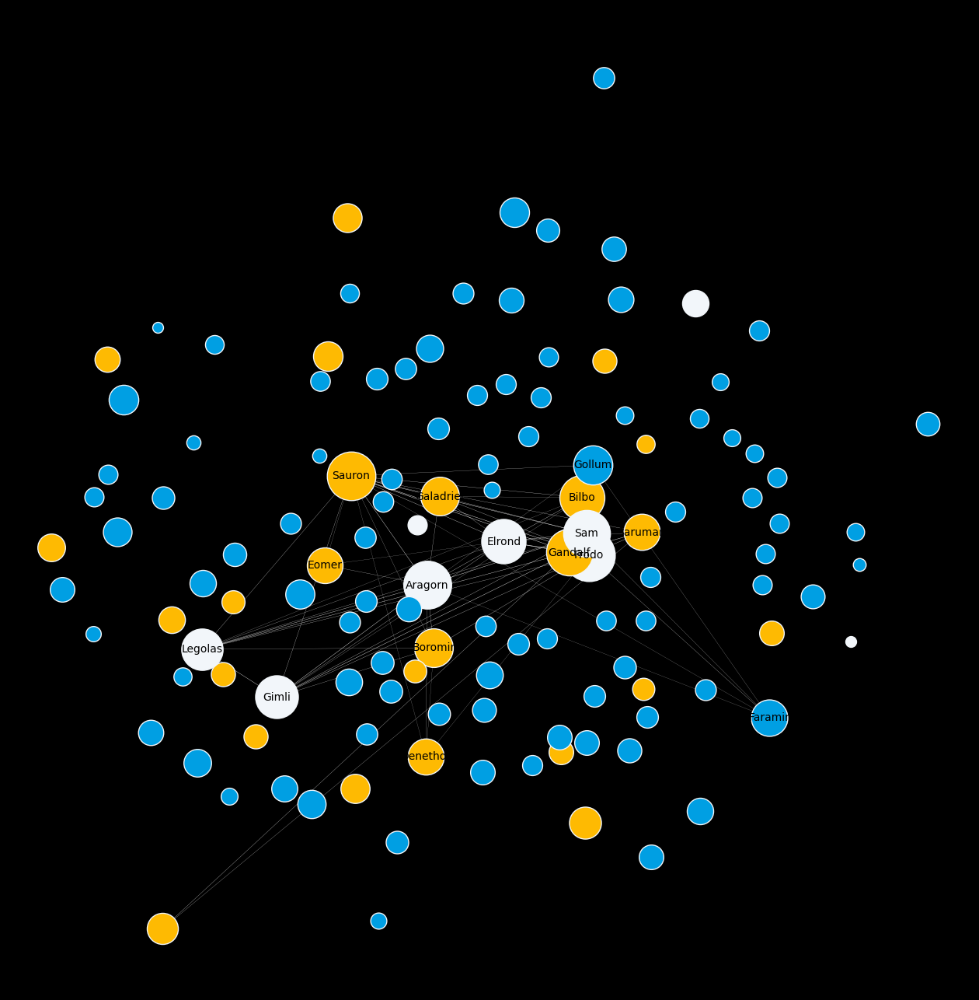

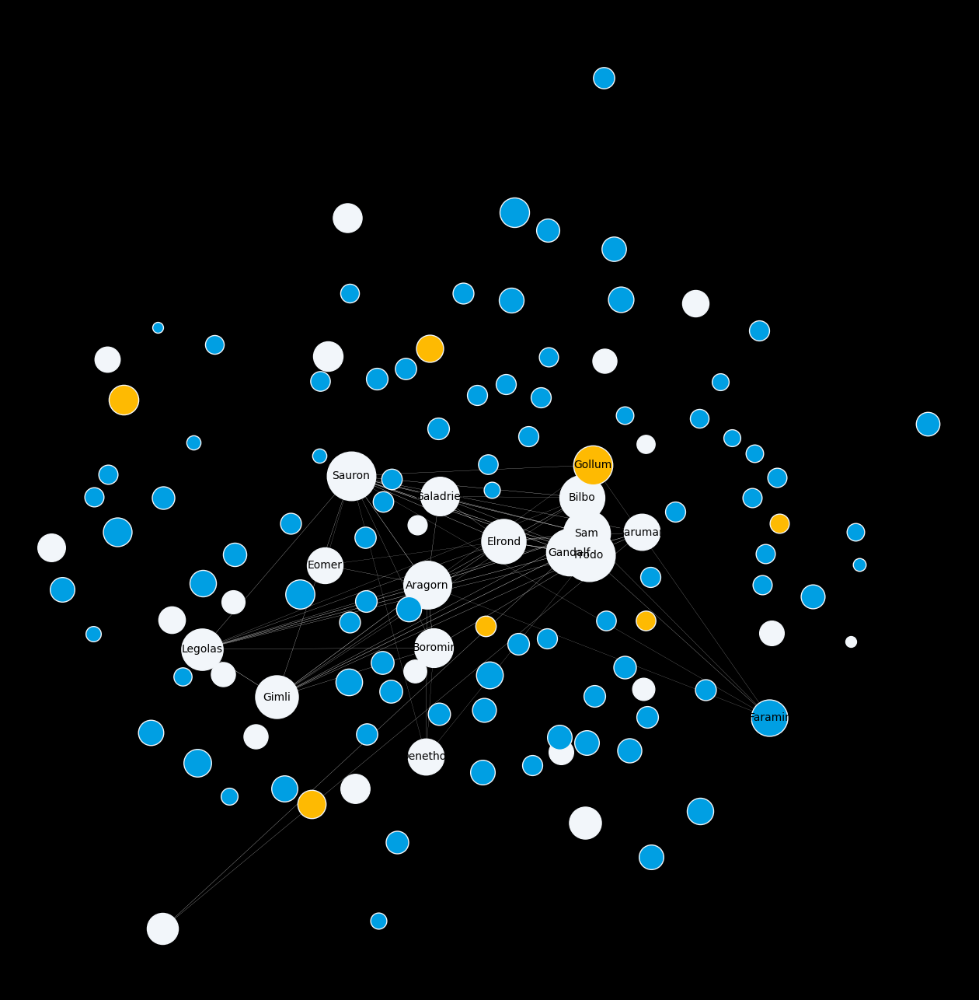

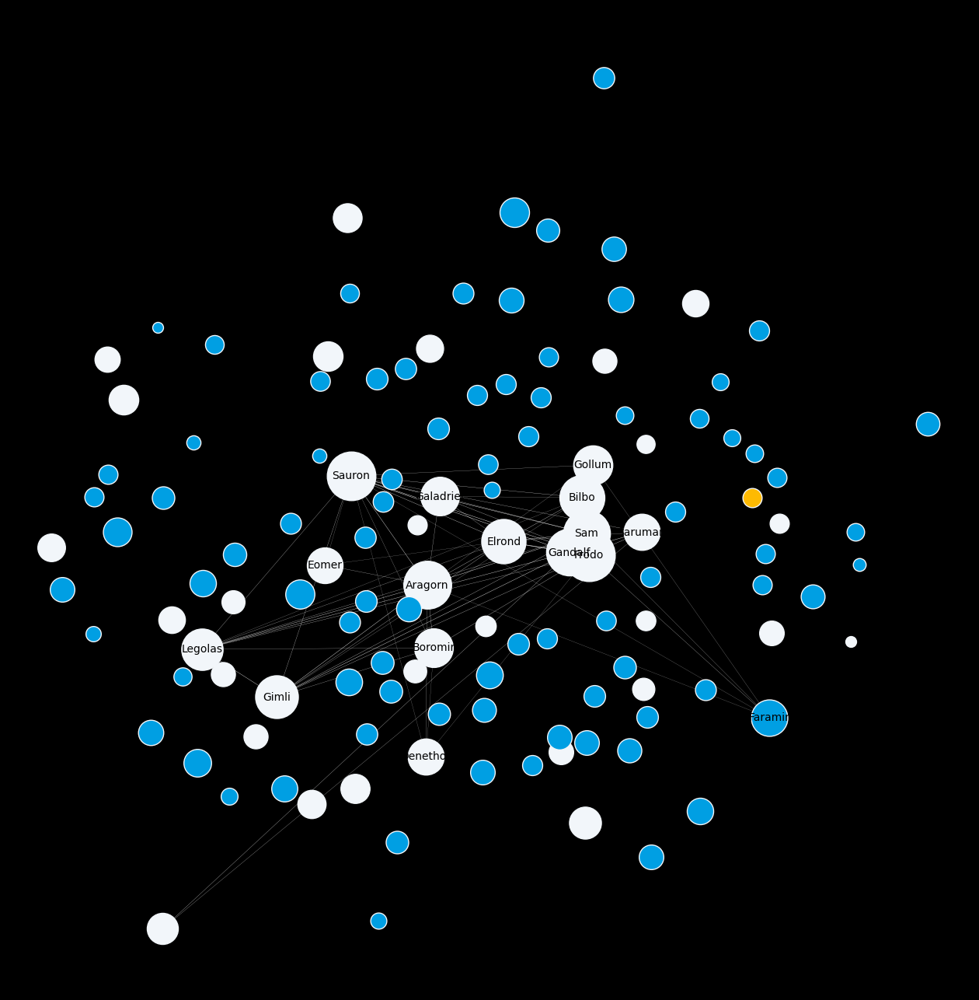

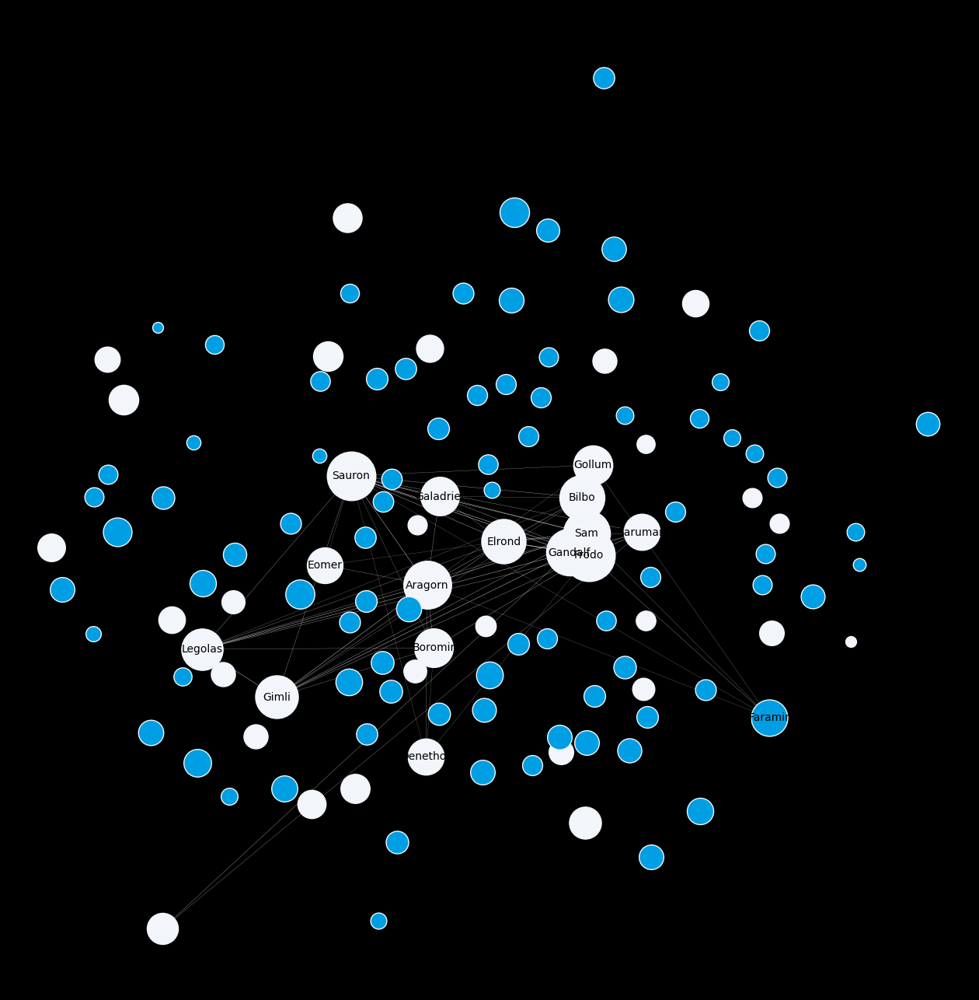

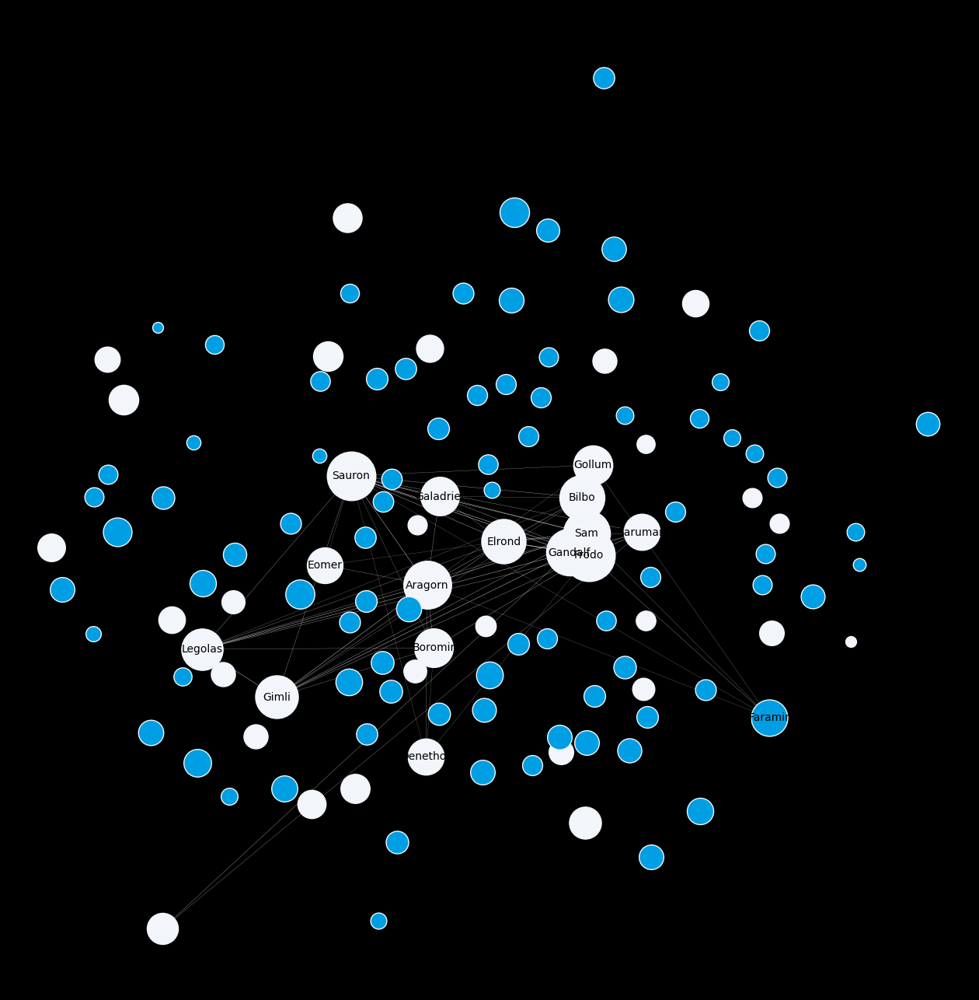

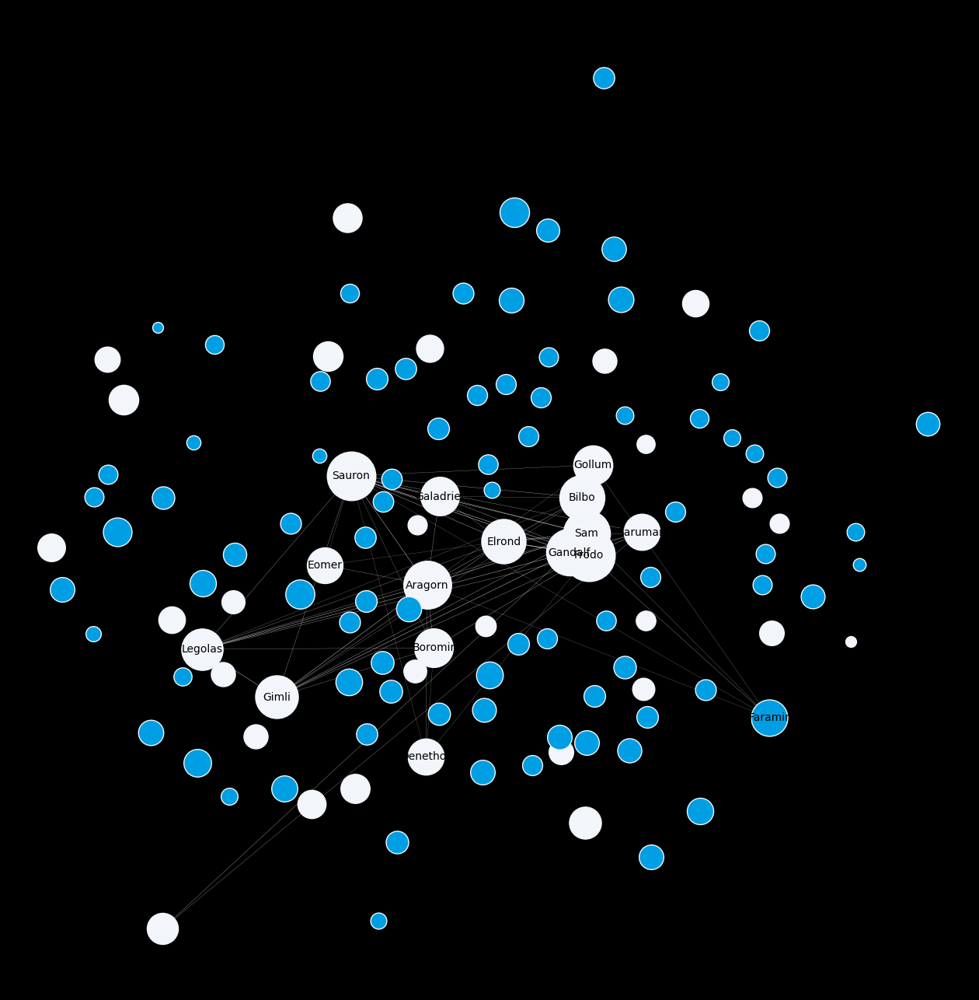

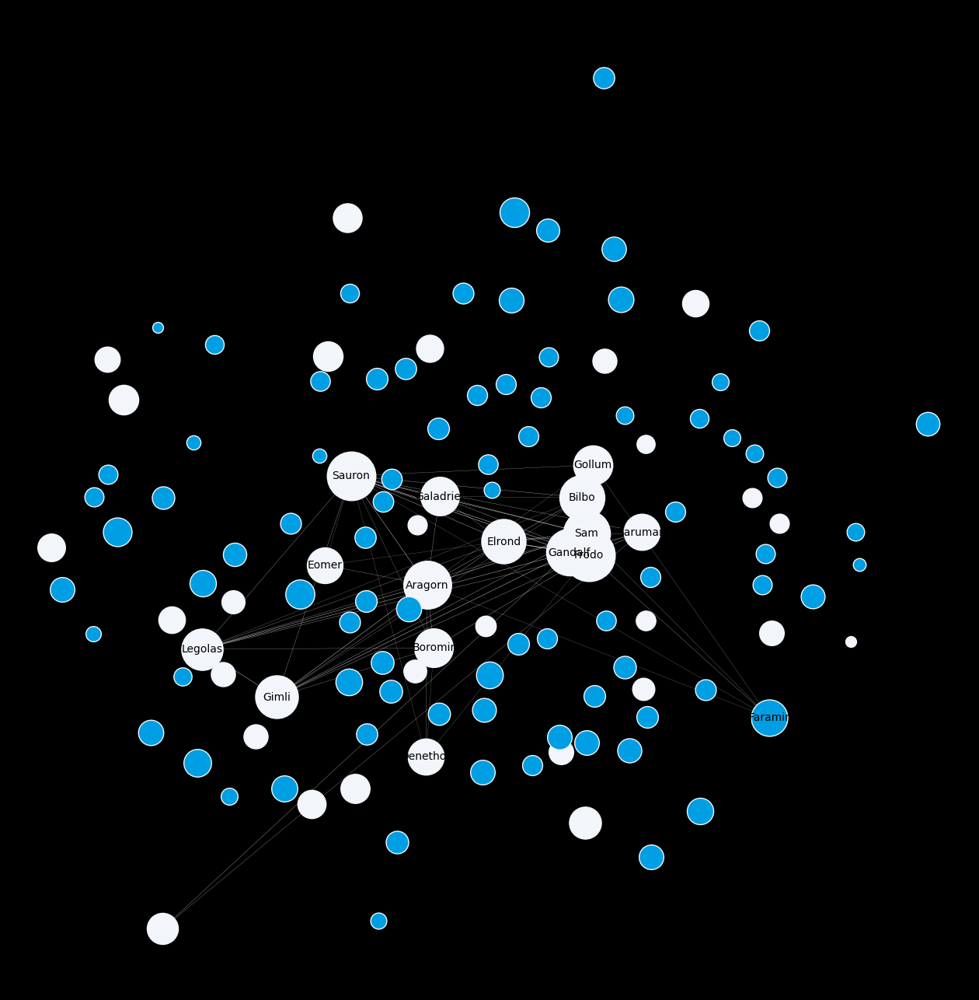

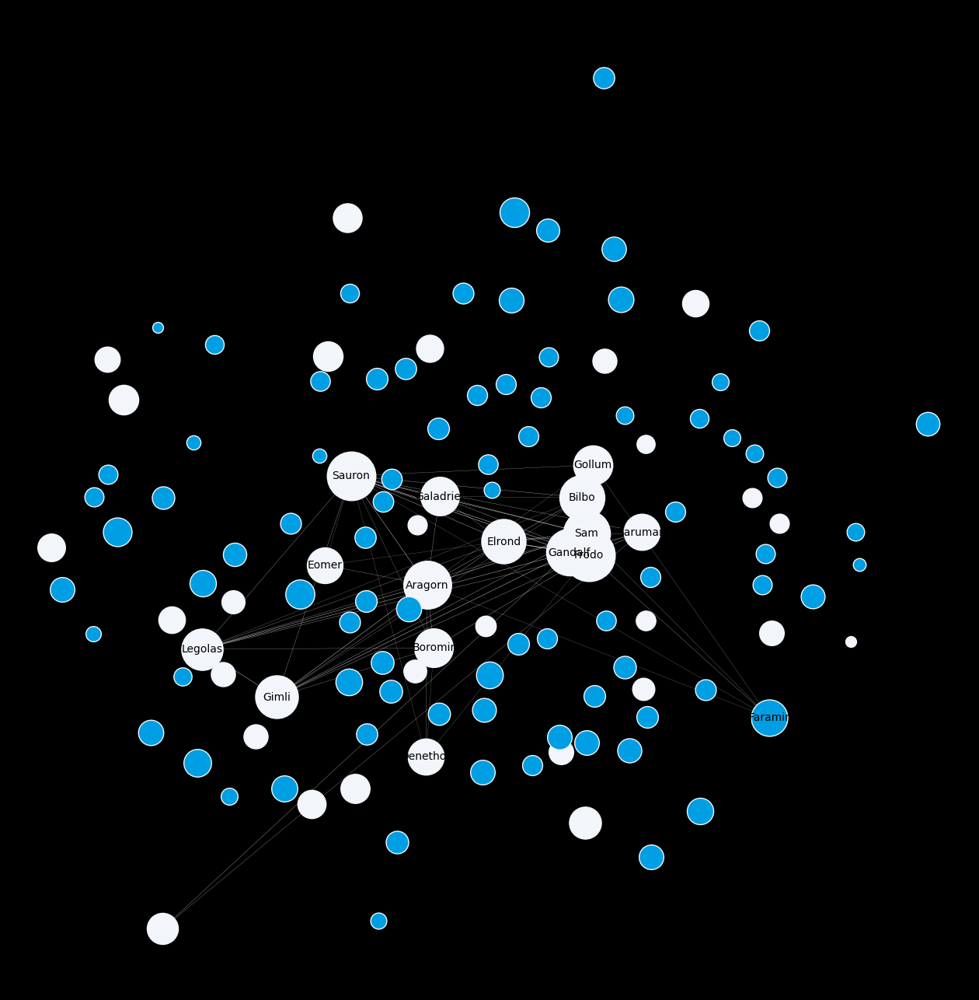

In [72]:
for t in range(10):
    plot_G(G,pos,infection_times,t)
    infection_times = independent_cascade(G,t,infection_times)

In the previous plots, you can see how a rumour started by Rosie (which is not such a relevant character in the plot) and transmitted by her to Sam, spreads through Middle-Earth inhabitants and finally die. Do you want to check how a rumour spreads depending on the first interaction? Go to cell 70 and change the characters in "infection_times" to check it!

# **6. Sentiment Analysis**

Is Sauron the evilest? And are the Hobbits as happy as it is said throughout Middle Earth? How does the sentiments evolve as the quest advances?  From the despair of Frodo and Sam on their journey to Mount Doom, to the righteous anger of Aragorn and the hobbits in defense of their homeland, the sentiment expressed by the characters can reveal the underlying themes of the story. Moreover, sentiment analysis can help us identify patterns in the emotional arcs of the characters, revealing how their feelings change over time and in response to major events.

These questions and many more will be uncovered in the following section.

We have to start by explaining SentiWordNet. SentiWordNet is a lexical resource for sentiment analysis, with 155,000 words, that assigns sentiment scores to synsets (groups of synonyms representing a concept) in WordNet, a large lexical database of English. The sentiment scores range from -1 (very negative) to 1 (very positive), with 0 representing neutral sentiment.SentiWordNet assigns scores to each word indicating how positive, negative, or neutral it is. These scores can range from -1 to 1, with negative scores indicating a negative sentiment and positive scores indicating a positive sentiment. Zero represents neutrality. Therefore, if the sentiment of a word is strongly negative, it may have a negative score in SentiWordNet.

In [73]:
#Downloading what is needed
nltk.download('sentiwordnet')
nltk.download('omw-1.4')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')
nltk.download('punkt')

[nltk_data] Downloading package sentiwordnet to
[nltk_data]     C:\Users\alfon\AppData\Roaming\nltk_data...
[nltk_data]   Package sentiwordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\alfon\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\alfon\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\alfon\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\alfon\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\alfon\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-dat

True

In [74]:
#Importing SentiWordNet
import nltk
import re
import numpy as np
from nltk.tokenize import word_tokenize
from collections import defaultdict
from nltk.corpus import sentiwordnet as swn
from nltk.corpus import stopwords

In [75]:
cachedStopWords = stopwords.words("english")

#Removes unwanted characters for the TFIDF calculation.
def remove_special_characters(string):
    #Removes the \n from the downloaded txt. 
    stripped = string.replace('\n', '') 
    #Removes commas, and punctiation but keeps hyphens.
    stripped = re.sub('[^\w\s{P}-]','',string)
    #Make everything lowercase. All the stopwords are in lowercase.
    stripped = stripped.lower()
    #Remove stopwords. Need to do that before removing parentheses.
    stripped = ' '.join([word for word in stripped.split() if word not in cachedStopWords])
    #Removes characters, not present in the list.
    stripped = re.sub('[ ](?=[ ])|[^-_,A-Za-z0-9 ]+', '', stripped)
    #Remove numbers
    stripped = re.sub(r'[0-9]+', '', stripped) 
    #Removes underscores (should do that in the line before.)
    stripped = re.sub('_','',stripped)
    #All whitespace characters become a single whitespace.
    stripped = re.sub('\s+',' ',stripped)
    stripped = stripped.strip()

    return stripped

In [76]:

def calc_sentiment(tokens):
    #print ('------ TOKENS -------', tokens)
    sentiment_score = []
    for token in tokens:
        synsets = list(swn.senti_synsets(token))
        if len(synsets) > 0:
            pos_score = synsets[0].pos_score()
            neg_score = synsets[0].neg_score()
            sentiment_score.append(pos_score - neg_score)
    if len(sentiment_score) == 0:
        return None
    else: 
        return sum(sentiment_score) / len(sentiment_score)



def textTokenizer(text):
    """
    input : 
    - text which has been processed with the text cleaner.
    output :
    - tokenized text
    """
    WordsTokenized = []
    for i in range(len(text)):
        WordsTokenized.append(word_tokenize(text[i]))
    return WordsTokenized

def sentimentCalculator(chapters):
    text_sents_clean = [remove_special_characters(s) for s in chapters]
    tokenizedText = textTokenizer(text_sents_clean)
    sentiment = []
    for i in range(len(tokenizedText)):
        sentiments = calc_sentiment(tokenizedText[i])
        sentiment.append(sentiments)
        
    return sentiment, tokenizedText, text_sents_clean

## 5.1 Sentiment Analysis for Chapters

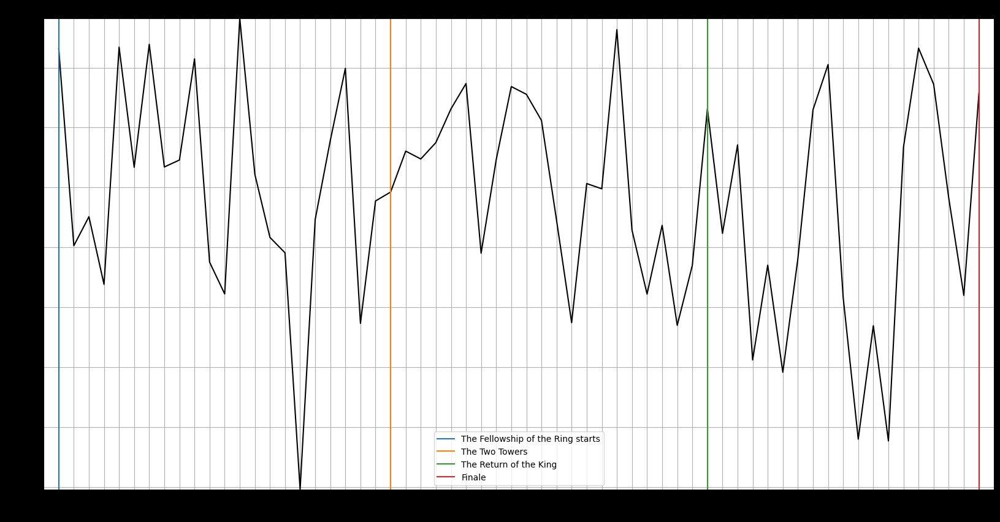

In [77]:
sents11, _, _ = sentimentCalculator(LOTR1_book1_chapters)
sents12, _, _ = sentimentCalculator(LOTR1_book2_chapters)
sents21, _, _ = sentimentCalculator(LOTR2_book1_chapters)
sents22, _, _ = sentimentCalculator(LOTR2_book2_chapters)
sents31, _, _ = sentimentCalculator(LOTR3_book1_chapters)
sents32, _, _ = sentimentCalculator(LOTR3_book2_chapters)


all_sents =sents11+sents12+sents21+sents22+sents31+sents32

l = range(1, 63) # number of chapters
plt.figure(figsize=(20,10))
plt.plot(l, all_sents, '-', color='black')
plt.plot((1, 1), (min(all_sents), max(all_sents)), '-', label='The Fellowship of the Ring starts')
plt.plot((23, 23), (min(all_sents), max(all_sents)), '-', label='The Two Towers')
plt.plot((44, 44), (min(all_sents), max(all_sents)), '-', label='The Return of the King')
plt.plot((62, 62), (min(all_sents), max(all_sents)), '-', label='Finale')
plt.xticks(l)
plt.xlim(0, 63)
plt.ylim(min(all_sents), max(all_sents))
plt.grid(True)
plt.legend()
plt.xlabel('Chapter')
plt.title("Sentiment analysis of every chapter Using SentiWordNet")
plt.show()

Based on the sentiment analysis with SentiWordNet, we can see that the sentiments expressed in the Lord of the Rings story range from 0.15 to -0.20, indicating a generally neutral to slightly negative sentiment throughout the story. This suggests that the story has a balanced mix of positive and negative emotions and experiences.

In terms of the individual books, we see that The Fellowship of the Ring has more frequent happy peaks than the other two books. However, it also has the lowest peak, reaching -0.20, which indicates a significant negative sentiment in the story (could this happen in the moment where Boromir tries to steal Frodo the ring and after is filled with regret and sacrifices himself to save the others?) This could be because the events in the book are largely focused on the formation of the Fellowship and their journey to destroy the Ring, which can be seen as a hopeful and positive mission, but is also filled with danger and uncertainty.

The Two Towers has more stability in sentiment, with a highest positive peak near the end (could this be the moment of hope when Gandalf reachs Helm's Deep?). This could be because the book largely focuses on the battles and events leading up to the battle of Helm's Deep, which is a major turning point in the story. While there are many battles and conflicts, there is also a sense of purpose and unity among the characters that may contribute to a more stable sentiment.

The Return of the King, despite having three really high moments of hope and positiveness, is by far the most negative book in terms of sentiment. This could be because the book largely focuses on the culmination of the story and the final battle against Sauron, which is a highly intense and emotionally charged event, where Frodo is struggling with a lot of negative sentiments but Sam is trying to encourage him with hope and positive messages. Additionally, the book deals with themes of loss and which may contribute to the negative sentiment.

<Figure size 1600x1600 with 0 Axes>

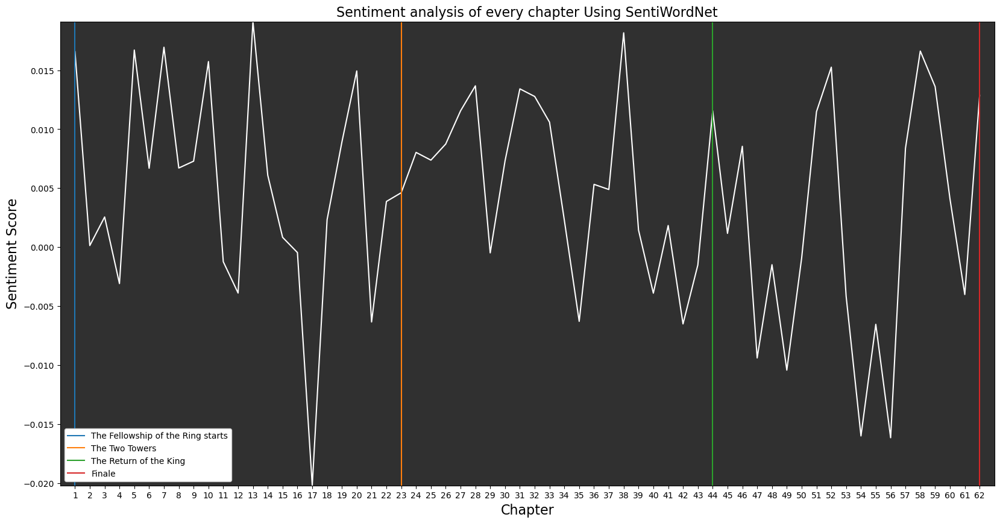

In [78]:
#Here we are just plotting the previous graph again (for using in the presentation)
sents11, _, _ = sentimentCalculator(LOTR1_book1_chapters)
sents12, _, _ = sentimentCalculator(LOTR1_book2_chapters)
sents21, _, _ = sentimentCalculator(LOTR2_book1_chapters)
sents22, _, _ = sentimentCalculator(LOTR2_book2_chapters)
sents31, _, _ = sentimentCalculator(LOTR3_book1_chapters)
sents32, _, _ = sentimentCalculator(LOTR3_book2_chapters)


all_sents =sents11+sents12+sents21+sents22+sents31+sents32
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = '#303030'
fig = plt.gcf()
fig.patch.set_facecolor('#303030')

l = range(1, 63) # number of chapters
plt.figure(figsize=(20,10))
plt.plot(l, all_sents, '-', color='white')
plt.plot((1, 1), (min(all_sents), max(all_sents)), '-', label='The Fellowship of the Ring starts')
plt.plot((23, 23), (min(all_sents), max(all_sents)), '-', label='The Two Towers')
plt.plot((44, 44), (min(all_sents), max(all_sents)), '-', label='The Return of the King')
plt.plot((62, 62), (min(all_sents), max(all_sents)), '-', label='Finale')
plt.xticks(l)
plt.xlim(0, 63)
plt.ylim(min(all_sents), max(all_sents))
plt.grid(False)
legend = plt.legend(loc='lower left', framealpha=1, facecolor='white')
legend.get_frame().set_alpha(1)
plt.xlabel('Chapter', fontsize=16)
plt.ylabel('Sentiment Score', fontsize=16)
plt.title("Sentiment analysis of every chapter Using SentiWordNet", fontsize=16)
plt.show()

In [79]:
plt.rcParams.update(plt.rcParamsDefault)

In [80]:
#Saving the results of the sentiment score per chapter in a dataframe
df_chapters = pd.DataFrame({'Chapter': [f'Chapter {i}' for i in range(1, 63)]})
#df_chapters
df_chapter_sent_score = pd.DataFrame(all_sents, columns=['SentimentScore'])
#print(df_chapter_sent_score)
#Merge the two dataframes on index
merged_df_chapters = pd.merge(df_chapters, df_chapter_sent_score, left_index=True, right_index=True)
#Print the merged dataframe
#print(merged_df_chapters)

In [81]:
#saving the nodes and sentiment to csv file
#merged_df_chapters.to_csv('dataset/nodes_chapter_sent.csv')

In [82]:
#We apply the look_for_connection_in_book function to the three volumes and all the chapters
#Here we are getting the characters in each chapter
new_network1 = look_for_connection_in_book(liste_of_names2,LOTR_volume1)
new_network2 = look_for_connection_in_book(liste_of_names2,LOTR_volume2)
new_network3 = look_for_connection_in_book(liste_of_names2,LOTR_volume3)
new_network4 = look_for_connection_in_book(liste_of_names2,All_chapter)
#new_network4

In [83]:
df_characters= pd.read_csv("dataset/cleaned_name.csv",';')
characters = list(df_characters['Names'])

In [84]:
import networkx as nx

#Collect the plot characters
plot_characters = set(characters)
#print(plot_characters)

In [85]:
#2. Create the edges
edges = []
for i in range(len(new_network4)):
    chars = set(new_network4[i]).intersection(plot_characters)
    for j in range(i+1, len(new_network4)):
        chars2 = set(new_network4[j]).intersection(plot_characters)
        common_chars = chars.intersection(chars2)
        if common_chars:
            edges.append((f"Chapter {i+1}", f"Chapter {j+1}", len(common_chars)))
            #edges.append((i+1, j+1, len(common_chars)))

#edges

In [86]:
#already saved the weighted edges to csv, so commenting this section

'''
import csv
# save the weights as a csv. This file includes how many common characters are between the chapters
with open('dataset/edges_chapters.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['From', 'To', 'weight'])
    for edge in edges:
        writer.writerow(edge)
'''

"\nimport csv\n# save the weights as a csv. This file includes how many common characters are between the chapters\nwith open('dataset/edges_chapters.csv', mode='w', newline='') as file:\n    writer = csv.writer(file)\n    writer.writerow(['From', 'To', 'weight'])\n    for edge in edges:\n        writer.writerow(edge)\n"

In [87]:
# 3. Visualize the graph of chapters and their connections (weigths are common characters between chapters)
G3 = nx.Graph()
#G3.add_nodes_from(nodes)

edge_list = [(u, v, w) for (u, v, w) in edges]
G3.add_weighted_edges_from(edge_list)

# Print the number of nodes and edges in the graph
print(f"Number of nodes: {G3.number_of_nodes()}")
print(f"Number of edges: {G3.number_of_edges()}")

Number of nodes: 67
Number of edges: 2082


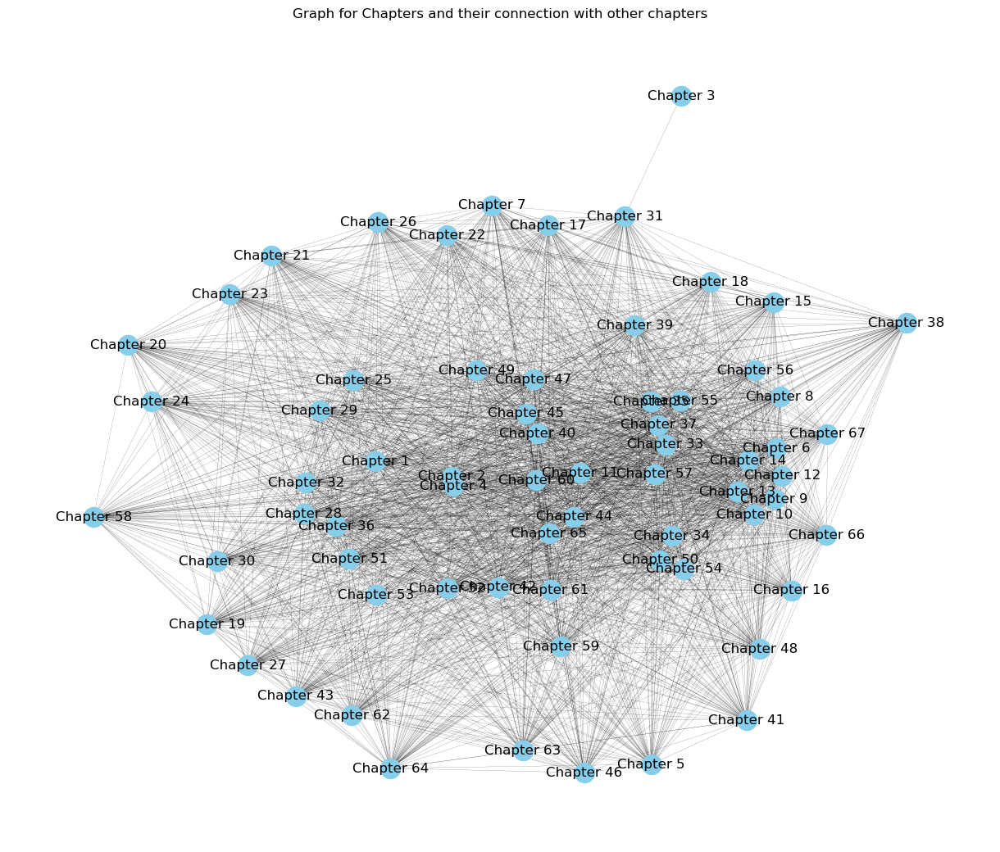

In [88]:
# Visualizing the a raw graph (nodes and edges - without sentiment)
plt.figure(figsize=(12,10))
pos = nx.kamada_kawai_layout(G3)
nx.draw(G3, with_labels=True, node_color='skyblue', width=0.1,edge_cmap=plt.cm.Blues, pos = pos)
plt.title("Graph for Chapters and their connection with other chapters")
plt.show()

In [89]:
merged_df_chapters

,Chapter,SentimentScore
0,Chapter 1,0.016572
1,Chapter 2,0.000138
2,Chapter 3,0.002559
3,Chapter 4,-0.003085
4,Chapter 5,0.016708
...,...,...
57,Chapter 58,0.016624
58,Chapter 59,0.013610
59,Chapter 60,0.004111
60,Chapter 61,-0.004011


In the following, we are going to re-create the previous graph yet giving each node an attribute, which is the SentimentScore per chapter (computed before), then plot the graph with those nodes with different colors indicating sentiment

In [90]:

#Read in the node sentiment data
node_data_sent = pd.read_csv('dataset/nodes_chapter_sent.csv')


#Read in the edge weight data
edge_data_sent = pd.read_csv('dataset/edges_chapters.csv')


#Create a new empty graph
G4 = nx.Graph()

#Add nodes to the graph with their respective sentiment scores
for index, row in node_data_sent.iterrows():
    try:
        # convert sentiment score to float
        sentiment = float(row['SentimentScore'])
        #print('--------', sentiment)
        G4.add_node(row['Chapter'], SentimentScore=sentiment)
        #print(f"Node attributes: {nx.get_node_attributes(G4, 'SentimentScore')}")
    except ValueError:
        print(f"Error: SentimentScore is not numeric for node '{row['Chapter']}'")

#Add edges to the graph with their corresponding weights
for index, row in edge_data_sent.iterrows():
    try:
        # convert weight to float
        weight = float(row['weight'])
        G4.add_edge(row['From'], row['To'], weight=weight)
    except ValueError:
        print(f"Error: weight is not numeric for edge ({row['From']}, {row['To']})")


#Print some information about the graph
print(f'Number of nodes: {G4.number_of_nodes()}')
print(f'Number of edges: {G4.number_of_edges()}')
#print(f"Node attributes: {nx.get_node_attributes(G4, 'SentimentScore')}")
#print(f"Edge weights: {nx.get_edge_attributes(G4, 'weight')}")

Number of nodes: 67
Number of edges: 2082


In [91]:
#Get the sentiment scores of each node as a dictionary
sentiment_dict1 = nx.get_node_attributes(G4, 'SentimentScore')
#print(sentiment_dict1)

#Set the node size to be a scalar value equal to the average sentiment score
node_sizes_chapter1 = [sentiment_dict1[node] * 100000 for node in G4.nodes() if node in sentiment_dict1]


node_colors_chapter1 = [sentiment_dict1[node] if node in sentiment_dict1 else 0 for node in G4.nodes()]
labels = {node: node for node in G4.nodes()}

#print(len(G4.nodes()))
#print(type(node_sizes_chapter1))


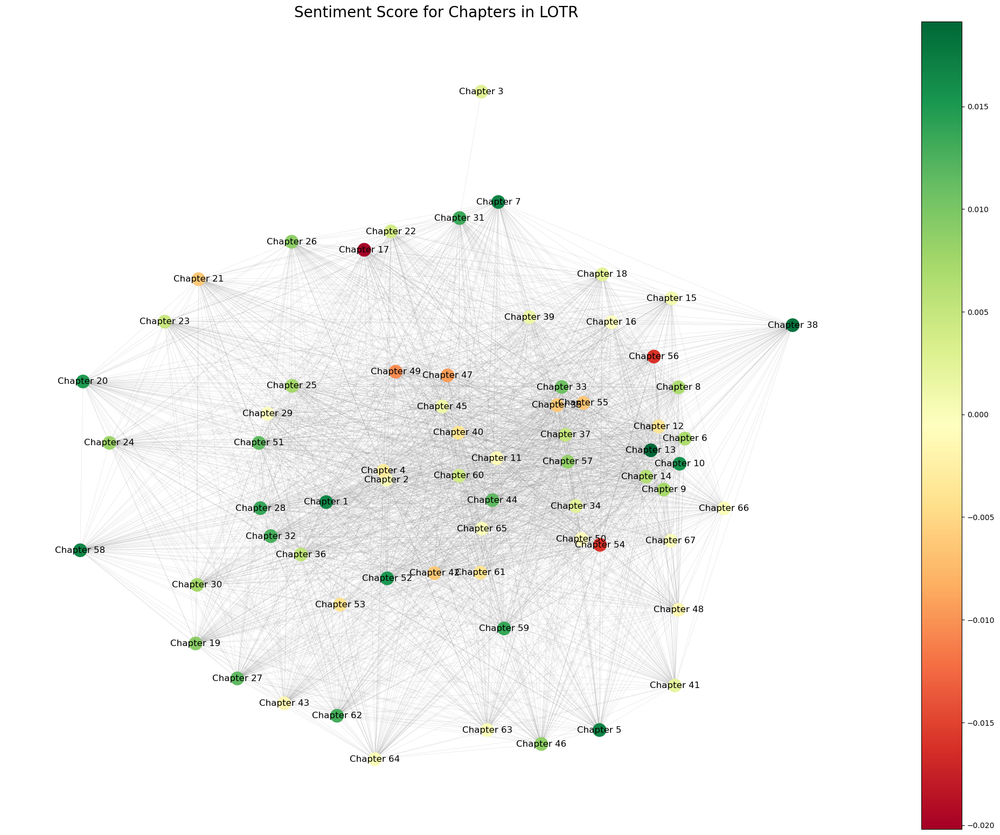

In [92]:
plt.rcParams['figure.facecolor'] = 'black'
plt.figure(figsize=(20,15))
pos = nx.kamada_kawai_layout(G4)
#plt.rcParams['axes.facecolor'] = '#303030'
#fig = plt.gcf()
#fig.patch.set_facecolor('#303030')

# Draw the graph with node colors
nx.draw(G4, pos=pos, with_labels=True,
        cmap=plt.cm.RdYlGn, node_color=node_colors_chapter1,
        edge_color='gray', width=0.1, labels=labels)


sm = plt.cm.ScalarMappable(cmap=plt.cm.RdYlGn, norm=plt.Normalize(vmin=min(node_colors_chapter1), vmax=max(node_colors_chapter1)))
sm._A = []
plt.colorbar(sm)

#Show the plot
plt.title("Sentiment Score for Chapters in LOTR", fontsize=20)
plt.show()

Considering to refresh Lord of the Rings and read again? Maybe you can select some chapters as relaxing refreshers or other chapters that are considered the most intense ones. </br>

If you want chapters with **positive sentiment**, you may read those dark green labeled chapters, or if you are up to the most negative sentiment chapters then go for Chapters 17, 54 or 56.

Just for giving you an appetizer, we can now present **chapter 17** a.k.a. "the most negative chapter in the whole Lord Of the Rings Plot". This chapter is titled "A Journey in the Dark". In this chapter, the Fellowship continues their journey through the Mines of Moria, where they face many dangers, including an attack by the Watcher in the Water, a cave troll, and a group of orcs. However, the most negative event in this chapter occurs towards the end, when the Fellowship is confronted by a powerful Balrog... If you don't know what happens next, we won't spoil the surprise!

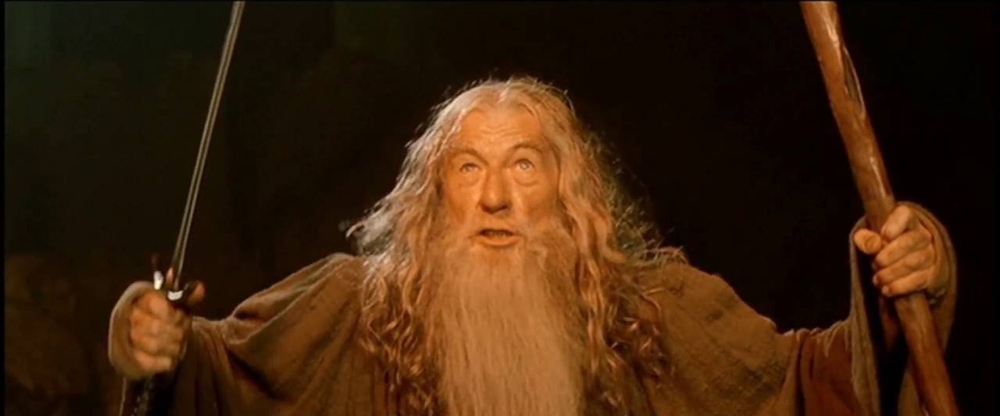

In [93]:
Image(filename='Images/gandalf.png')


## 5.2. Sentiment Analysis for Characters

In this section we are demonstrating sentiment analysis per character. We use movie script, where we can extract dialouge for characters and analyze sentiment and get average sentiment per character across the three (3) movies. This is a step for taking this average sentiment per character and assign it as an atribute to the graph nodes to do further analysis.

In [94]:
import math 

df_script = pd.read_csv("dataset/lotr_scripts.csv")

def split_in_three_movie(dataframe):
    list_lotr1 = []
    list_lotr2 = []
    list_lotr3 = []
    for row in dataframe.iterrows():
        movie = row[1].movie
        name_split = row[1].char.split()
        name = ""
        for element in name_split:
            if element in ['VOICE', 'VOICEOVER', 'OVER','SHOUT']:
                continue
            else:
                name += element + " "   
        name = name.rstrip()
        if "The Fellowship of the Ring" in movie:
            list_lotr1.append((name, row[1].dialog))
        elif "The Two Towers" in movie:
            list_lotr2.append((name, row[1].dialog))
        elif "The Return of the King" in movie:
            list_lotr3.append((name, row[1].dialog))
    return list_lotr1,list_lotr2,list_lotr3

def create_dict_for_dialogues(list_of_dialogues):
    unique_names = []
    for element in list_of_dialogues:
        if element[0] not in unique_names:
            unique_names.append(element[0])
    dict_of_dialogues = {}
    for name in unique_names:
        dict_of_dialogues[name] = ""
    for element in list_of_dialogues:
        if not(type(element[1]) is float):
            dict_of_dialogues[element[0]] = dict_of_dialogues[element[0]] + element[1]+ ". "
    return dict_of_dialogues

def create_files_for_characters_dialogues(folder_name, dict_name):
    for name, dialogues in dict_name.items():
        filename = folder_name + "/" + name + '.txt'
        f = io.open(filename,'w')
        f.write(unicode(dialogues))
        f.close
    return True

def generate_dialog_file(filename, dest_directory):
    lotr_dict = create_dict_for_dialogues(dialogue_cleaned)
    create_files_for_characters_dialogues(dest_directory, lotr_dict)
    return True


In [95]:
LOTR1_list,LOTR2_list,LOTR3_list =  split_in_three_movie(df_script)

dict1 = create_dict_for_dialogues(LOTR1_list)
dict2 = create_dict_for_dialogues(LOTR2_list)
dict3 = create_dict_for_dialogues(LOTR3_list)

In [96]:
#Get list of characters
df_characters= pd.read_csv("dataset/cleaned_name.csv",';')
characters = list(df_characters['Names'])
#characters 

In [97]:
listi1 = []
for key, value in dict1.items():
    text_for_sentiment = remove_special_characters(dict1[key])
    sentiment_value = calc_sentiment(word_tokenize(text_for_sentiment))
    if sentiment_value is not None:
        listi1.append({"Name": key,
                       "Text for sentiment": text_for_sentiment,
                       "Sentiment value": sentiment_value,
                       "Text for TFIDF": remove_special_characters(dict1[key]),
                       "Words spoken": len(word_tokenize(remove_special_characters(dict1[key]))),
                       "Original": dict1[key]})
        


listi2 = []
for key, value in dict2.items():
    text_for_sentiment = remove_special_characters(dict2[key])
    sentiment_value = calc_sentiment(word_tokenize(text_for_sentiment))
    listi2.append({"Name" : key,
                  "Text for sentiment" : text_for_sentiment,
                  "Sentiment value" : sentiment_value,
                  "Text for TFIDF" : remove_special_characters(dict2[key]),
                  "Words spoken" : len(word_tokenize(remove_special_characters(dict2[key])))})

listi3 = []
for key, value in dict3.items():
    text_for_sentiment = remove_special_characters(dict3[key])
    sentiment_value = calc_sentiment(word_tokenize(text_for_sentiment))
    listi3.append({"Name" : key,
                  "Text for sentiment" : text_for_sentiment,
                  "Sentiment value" : sentiment_value,
                  "Text for TFIDF" : remove_special_characters(dict3[key]),
                  "Words spoken" : len(word_tokenize(remove_special_characters(dict3[key])))})

In [98]:
def listcreater(listi, index1, index2):
    newlist = []
    for i in range(len(listi)):
        name = listi[i][index1]
        value = listi[i][index2]
        if value is None:
            value = 0
        temp = [name, value]
        newlist.append(temp)
    newlist_sorted = sorted(newlist, key=lambda k: k[1], reverse=True)
    return newlist_sorted



    
LOTR1_wordsspoken = listcreater(listi1,'Name','Words spoken')
LOTR2_wordsspoken = listcreater(listi2,'Name','Words spoken')
LOTR3_wordsspoken = listcreater(listi3,'Name','Words spoken')
LOTR1_sentiment = listcreater(listi1,'Name','Sentiment value')
LOTR2_sentiment = listcreater(listi2,'Name','Sentiment value')
LOTR3_sentiment = listcreater(listi3,'Name','Sentiment value')


In [99]:
def dict_maker(Movie1, Movie2, Movie3, Movie4, Movie5, Movie6, Col1, Col2, Col3, Col4, Col5, Col6, Col7, Col8):
    
    new_dict = {}
    for item in Movie1:
        name = item[0]
        temp1 = item[1]
        temp2 = 0
        temp3 = 0
        temp4 = 0
        temp5 = 0
        temp6 = 0
        for i in range(len(Movie2)):
            if Movie2[i][0] == name:
                temp2 = Movie2[i][1]
                break
        for i in range(len(Movie3)):
            if Movie3[i][0] == name:
                temp3 = Movie3[i][1]
                break
        for i in range(len(Movie4)):
            if Movie4[i][0] == name:
                temp4 = Movie5[i][1]
                break
        for i in range(len(Movie5)):
            if Movie5[i][0] == name:
                temp5 = Movie5[i][1]
                break
        for i in range(len(Movie6)):
            if Movie6[i][0] == name:
                temp6 = Movie6[i][1]
                break
        denominator = temp1 + temp2 + temp3
        if denominator == 0:
            temp7 = 0
        else:
            temp7 = (temp1*temp4 + temp2*temp5 + temp3*temp6) / denominator
        new_dict[name] = {
            Col1: temp1,
            Col2: temp2,
            Col3: temp3,
            Col4: temp4,
            Col5: temp5,
            Col6: temp6,
            Col7: denominator,
            Col8: temp7
        }
        All_data = pd.DataFrame(new_dict).T
    return All_data

All_data = dict_maker(LOTR1_wordsspoken,LOTR2_wordsspoken,LOTR3_wordsspoken,  LOTR1_sentiment,LOTR2_sentiment,LOTR3_sentiment,'Words_LOTR1','Words_LOTR2','Words_LOTR3','Sent_LOTR1','Sent_LOTR2', 'Sent_LOTR3','Total_words','Avg_sent')


In [100]:
characters_analysis = pd.DataFrame(All_data)
characters_analysis
# name the index column
characters_analysis.index.name = 'Character'
characters_analysis.drop(index=['MEN', 'MAN'], inplace=True)

new_order = ['Words_LOTR1', 'Words_LOTR2', 'Words_LOTR3','Total_words','Sent_LOTR1', 'Sent_LOTR2', 'Sent_LOTR3','Avg_sent' ]
reordered_characters_analysis = characters_analysis.reindex(columns=new_order)
reordered_characters_analysis
sorted_characters_analysis = reordered_characters_analysis.sort_values(by='Avg_sent', ascending=False)

# print the sorted dataframe
sorted_characters_analysis

,Words_LOTR1,Words_LOTR2,Words_LOTR3,Total_words,Sent_LOTR1,Sent_LOTR2,Sent_LOTR3,Avg_sent
Character,,,,,,,,
HOBBIT,13.0,0.0,3.0,16.0,0.562500,0.000000,0.000000,0.457031
ROSIE,3.0,0.0,2.0,5.0,0.354167,0.000000,0.000000,0.212500
GAFFER,16.0,0.0,0.0,16.0,0.107143,0.000000,0.000000,0.107143
BILBO,541.0,0.0,31.0,572.0,0.067164,0.000000,-0.053571,0.060621
PIPPIN,107.0,185.0,329.0,621.0,0.125000,0.067164,0.030669,0.057795
STRIDER,144.0,0.0,0.0,144.0,0.051966,0.000000,0.000000,0.051966
BOROMIR,157.0,67.0,0.0,224.0,0.038793,0.046053,0.000000,0.040964
MERRY,108.0,194.0,202.0,504.0,0.046053,0.058394,0.016566,0.038985
GOLLUM,7.0,451.0,288.0,746.0,0.625000,0.032895,0.033163,0.038554


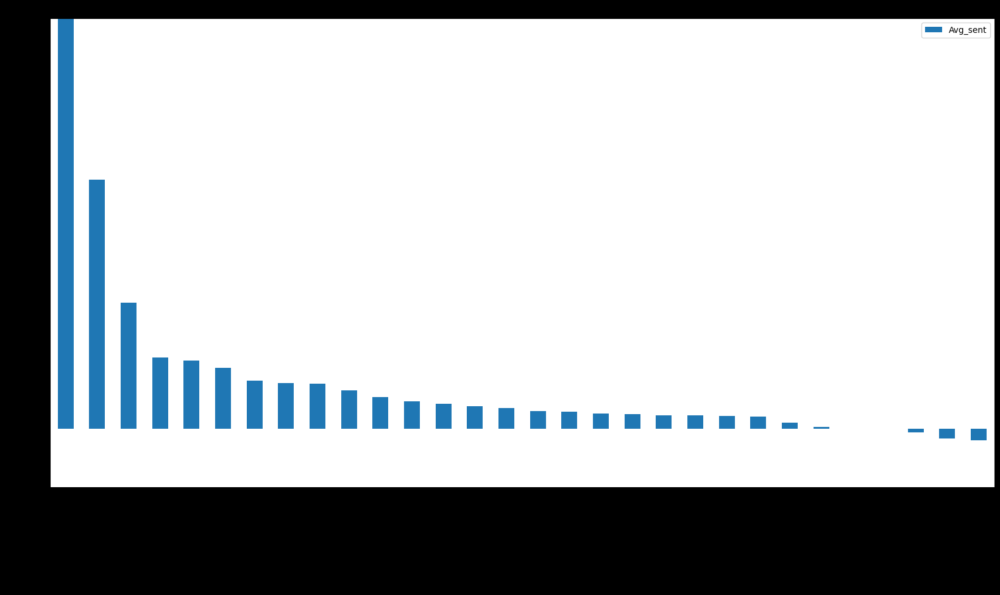

In [101]:
#Plotting the characters by average sentiment 
sorted_characters_analysis.drop(['Sent_LOTR1','Sent_LOTR2', 'Sent_LOTR3','Total_words','Words_LOTR1','Words_LOTR2', 'Words_LOTR3','Total_words'], axis=1).plot.bar(figsize=(20,10))
plt.title('Characters in the LOTR trilogy, ranked by sentiment.')
plt.xlabel('Characters')
plt.ylabel('Average Sentiment')
plt.ylim(-0.05,0.35)
plt.show()

Really interesting results here!!

Pippin and Merry can be seen as really positive characters, and that is not a surprise!

**A more surprising fact is Gollum appearing in the positive characters, or Elrond and Legolas as two of the most negatives ones.**

This can be explained by the fact that Gollum has a fragmented personality, going from a benevolent personality to an evil one in a matter of seconds. However, his actions end up having a positive undertone, albeit driven by an irrepressible obsession.

Legolas is always in battle scenes, which may contribute to his use of negative vocabulary. Elrond has a taciturn personality and a certain pessimism towards the final outcome of events.

Sauron is a really neutral character, probably because he does not talk too much through the plot, despite acting using other ways.

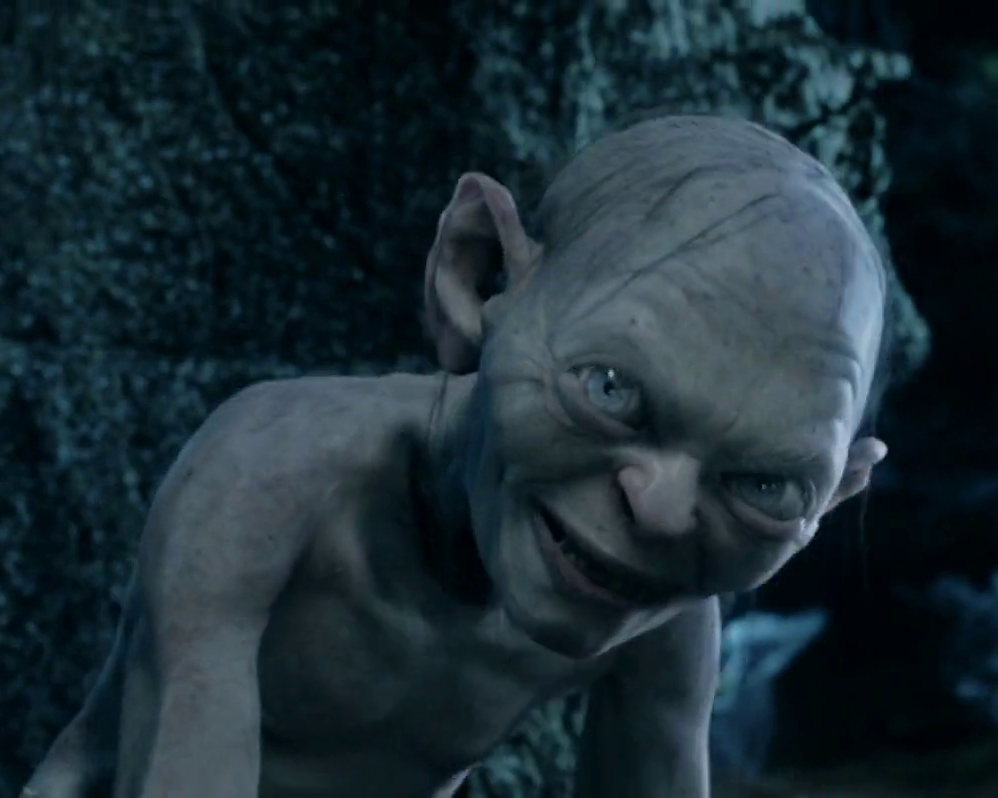

In [102]:
Image(filename='Images/gollum.png')

<Figure size 640x480 with 0 Axes>

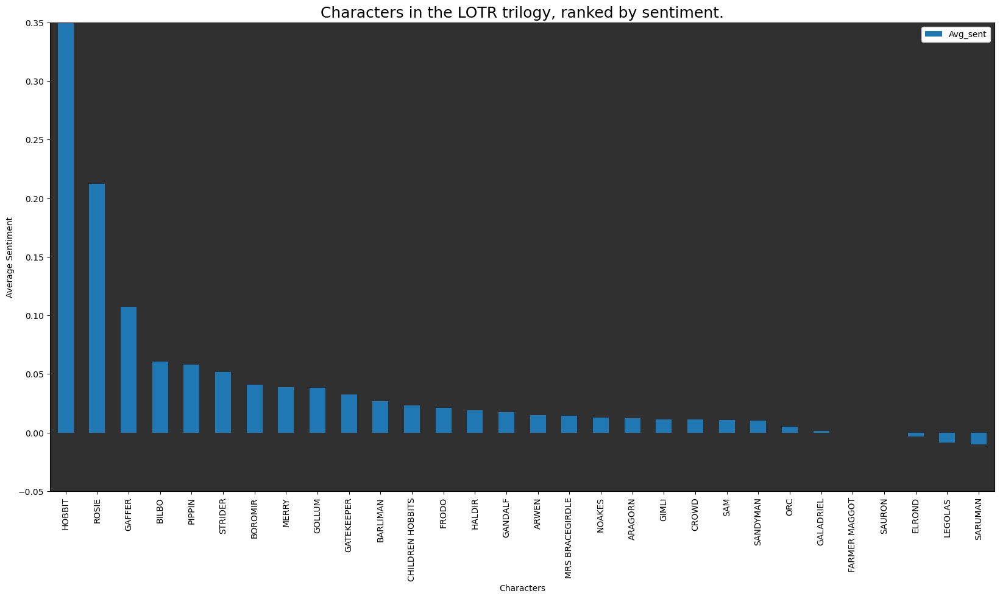

In [103]:
#Plotting the previous chart with dark background (to use in the presentation)

#Plotting the characters by average sentiment 
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = '#303030'
fig = plt.gcf()
fig.patch.set_facecolor('#303030')
sorted_characters_analysis.drop(['Sent_LOTR1','Sent_LOTR2', 'Sent_LOTR3','Total_words','Words_LOTR1','Words_LOTR2', 'Words_LOTR3','Total_words'], axis=1).plot.bar(figsize=(20,10))
plt.title('Characters in the LOTR trilogy, ranked by sentiment.', fontsize=18)
plt.xlabel('Characters')
plt.ylabel('Average Sentiment')
plt.ylim(-0.05,0.35)
legend = plt.legend(framealpha=1, facecolor='white')
legend.get_frame().set_alpha(1)
plt.show()

In [104]:
plt.rcParams.update(plt.rcParamsDefault)

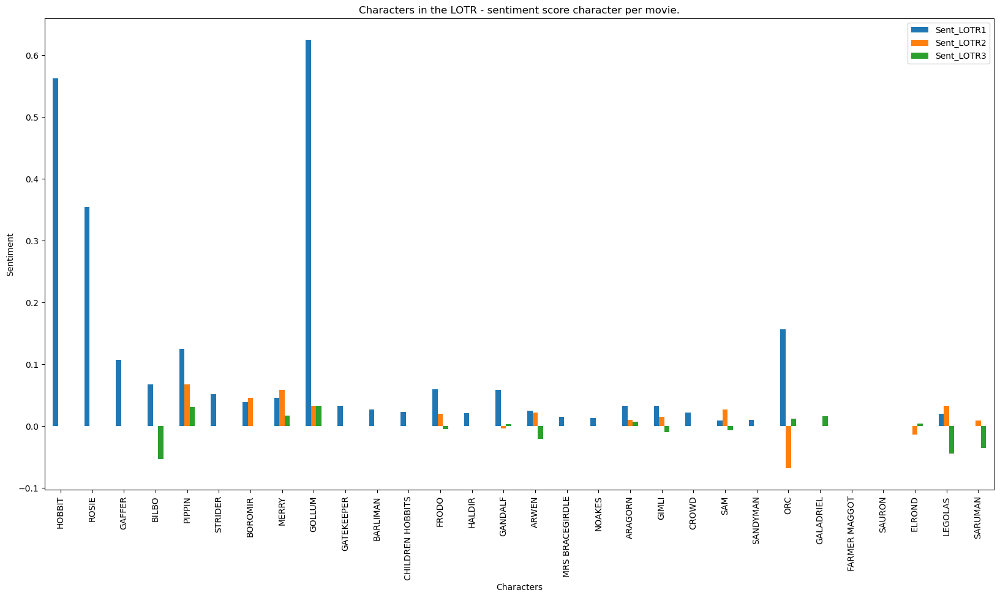

In [105]:
#Plotting the characters by sentiment in each movie
sorted_characters_analysis.drop(['Total_words','Words_LOTR1','Words_LOTR2', 'Words_LOTR3','Avg_sent'], axis=1).plot.bar(figsize=(20,10))
plt.title('Characters in the LOTR - sentiment score character per movie.')
plt.xlabel('Characters')
plt.ylabel('Sentiment')
plt.show()

In the previous graph, we have plot the sentiment analysis per movie. it is extremely striking to observe how Gollum goes from being the happiest character in book 1 to a character closer to neutral (due to his contrasting emotions). This may be due to the fact that in the first book he is reunited with the ring after decades, so his happiness is immense.

<Figure size 640x480 with 0 Axes>

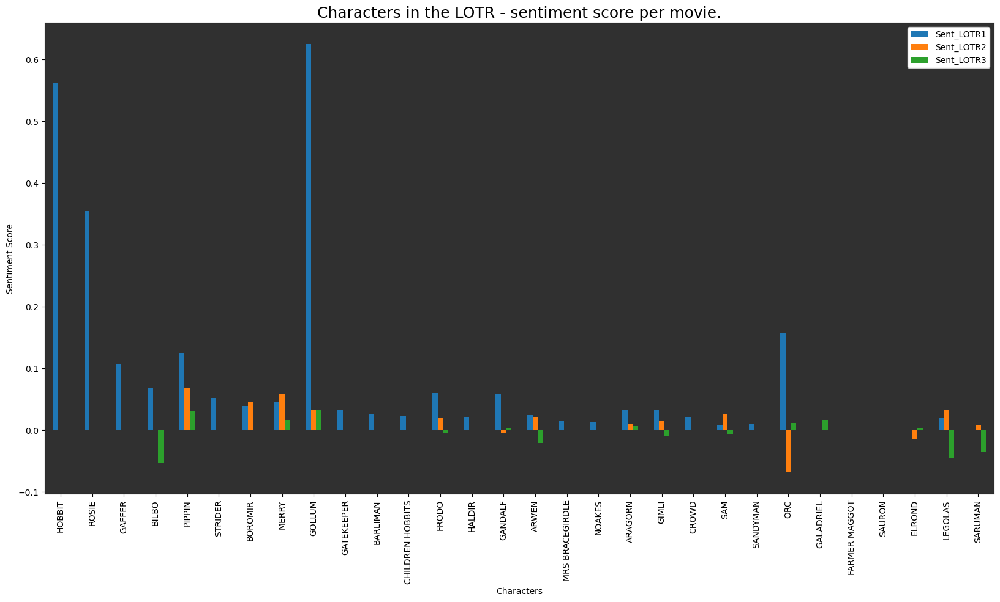

In [106]:
#Plotting the previous chart with dark background (to use in the presentation)

#Plotting the characters by sentiment in each movie
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = '#303030'
fig = plt.gcf()
fig.patch.set_facecolor('#303030')

sorted_characters_analysis.drop(['Total_words','Words_LOTR1','Words_LOTR2', 'Words_LOTR3','Avg_sent'], axis=1).plot.bar(figsize=(20,10))
plt.title('Characters in the LOTR - sentiment score per movie.', fontsize=18)
plt.xlabel('Characters')
plt.ylabel('Sentiment Score')
legend = plt.legend(framealpha=1, facecolor='white')
legend.get_frame().set_alpha(1)
plt.show()

In [107]:
plt.rcParams.update(plt.rcParamsDefault)

In [108]:
#save the dataframe as a csv file
#This is to use the data in the csv as attributes for nodes, mainly the Avg_sent which indicates the
#average sentiment per character
# save the dataframe as a CSV file with the index column
sorted_characters_analysis.to_csv('dataset/sentiment_per_character.csv', index=True)

In [109]:
sentiment_per_character = pd.read_csv('dataset/sentiment_per_character.csv')
#sentiment_per_character

In [110]:
nodes_updated = pd.read_csv('dataset/nodes.csv')
nodes_updated['Character'] = nodes_updated['Character'].str.lower()

sentiment_per_character['Character'] = sentiment_per_character['Character'].str.lower()
sentiment_per_character= sentiment_per_character.drop(['Words_LOTR1', 'Words_LOTR2','Words_LOTR3','Sent_LOTR1','Sent_LOTR2','Sent_LOTR3' ], axis=1)

merged_df = pd.merge(nodes_updated,sentiment_per_character, on='Character', how='left')
merged_df = merged_df.fillna(0)

#sentiment_per_character.shape
merged_df
#nodes_updated

,Index,Character,Race,Gender,Total_words,Avg_sent
0,n1,angbor,Man,Male,0.0,0.000000
1,n2,aragorn,Man,Male,771.0,0.012078
2,n3,arod,Animal,Male,0.0,0.000000
3,n4,arwen,Elf,Female,208.0,0.014883
4,n5,asfaloth,Animal,Male,0.0,0.000000
...,...,...,...,...,...,...
120,n121,radbug,Orc,Male,0.0,0.000000
121,n122,rosie cotton,Hobbit,Female,0.0,0.000000
122,n123,meneldor,Ainur,Male,0.0,0.000000
123,n124,mat heathertoes,Man,Male,0.0,0.000000


In [111]:
merged_df.to_csv("./dataset/nodes_with_sentiment.csv")

In [112]:
# Read in the node sentiment data
node_data = pd.read_csv('dataset/nodes_with_sentiment.csv')
node_data['character'] = node_data['Character'].str.lower()


# Read in the edge weight data
edge_data = pd.read_csv('dataset/weightededges.csv')
edge_data['From'] = edge_data['From'].str.lower()
edge_data['To'] = edge_data['To'].str.lower()

# Create a new empty graph
G1 = nx.Graph()

# Add nodes to the graph with their respective sentiment scores
for index, row in node_data.iterrows():
    G1.add_node(row['Character'], sentiment=row['Avg_sent'])

# Add edges to the graph with their corresponding weights
for index, row in edge_data.iterrows():
    G1.add_edge(row['From'], row['To'], weight=row['weight'])

# Print some information about the graph
print(f'Number of nodes: {G1.number_of_nodes()}')
print(f'Number of edges: {G1.number_of_edges()}')
#print(f"Node attributes: {nx.get_node_attributes(G1, 'sentiment')}")
#print(f"Edge weights: {nx.get_edge_attributes(G1, 'weight')}")

Number of nodes: 126
Number of edges: 1105


In [113]:
import matplotlib.pyplot as plt

# Get the sentiment scores of each node as a dictionary
sentiment_dict = nx.get_node_attributes(G1, 'sentiment')

# Convert the sentiment scores to node sizes
node_sizes = [sentiment_dict[node] * 100 for node in G1.nodes() if node in sentiment_dict]

# Create a subgraph with only the nodes that have sentiment scores
subgraph_nodes = [node for node in G1.nodes() if node in sentiment_dict]
subgraph = G1.subgraph(subgraph_nodes)

# Draw the subgraph with node sizes based on sentiment scores
node_sizes1 = [sentiment_dict[node] * 100000 for node in subgraph.nodes() if node in sentiment_dict]

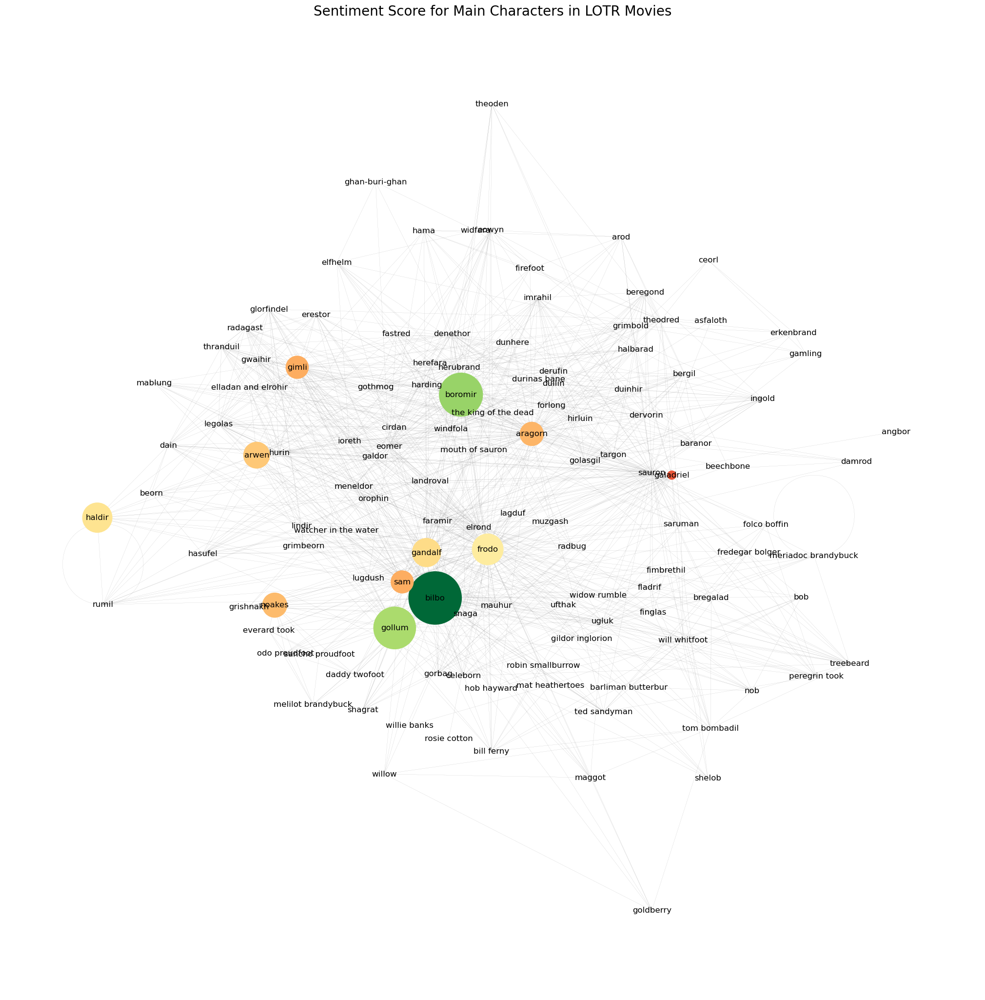

In [114]:
plt.figure(figsize=(20,20))

# Define the layout
pos = nx.kamada_kawai_layout(subgraph)

# Customize the node colors and labels
node_colors = [sentiment_dict[node] for node in subgraph.nodes()]
labels = {node: node for node in subgraph.nodes()}

# Draw the subgraph with node sizes based on sentiment scores
nx.draw(subgraph, pos=pos, with_labels=True, node_size=node_sizes1,
        cmap=plt.cm.RdYlGn, node_color=node_colors,
        edge_color='gray', width=0.1, labels=labels)



# Show the plot
plt.title("Sentiment Score for Main Characters in LOTR Movies", fontsize=20)
plt.tight_layout()
plt.show()

Now, it is time to say our farewells. We hope you enjoy this adventure that, despite having been hard, has been much easier to bear than transporting the ring to rule them all to Mordor!

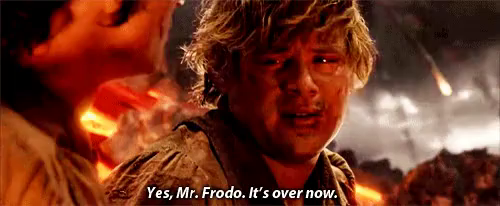

In [115]:
from IPython.display import Image
Image(filename='Images/its_over.png')